# Bank Statement Transactions - Segmentation


In [8]:
%matplotlib inline

# Some usual imports here
import csv as csv 
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import itertools

from datetime import datetime, timedelta
from IPython.display import IFrame    
from IPython.display import display
from seaborn import countplot

## Constants

In [9]:
# data directory
DATA_DIR = "C:\\Users\\johnm\\OneDrive - City, University of London\\MSc Data Science\\3. INM430 - Principles Data Science\\Coursework\\data\\"
REPORTS_DIR = "C:\\Users\\johnm\\OneDrive - City, University of London\\MSc Data Science\\3. INM430 - Principles Data Science\\Coursework\\reports\\"

## Sampling

There are over 100 million transactions in a 12 month period for 176K users with, 739K accounts. During the preliminary investigations I realized that it was not possible to use the full data set on a domestic laptop. This was the main driver behind applying sampling to the data. When reviewing the data it became clear that I would need to stratify the sample; gender and age were likely to fall out naturally but the region was heavily skewed so taking 10% of the sample would likely distort the regions even more than they already were. This was the driver behind choosing to stratify over region. 10% was a reasonably nominal amount of sample based on what I felt was a reasonable amount of sample and the computing power to hand.


In [10]:
# Pull users into a df
dfUsers = pd.read_csv("data\\Users.txt",sep="\t",header=None,names=["UserSID","RegionSID", "GenderCode", "YearOfBirth", "HomePostcode", "MosaicGroupCode"])

# loop through each region getting 10%
# Create empty data frame
dfUsersSubSample = pd.DataFrame()
for idemog in  range(1,13):
    dfUsersSubSample = dfUsersSubSample.append(dfUsers[dfUsers["RegionSID"] == idemog].sample(frac=0.1, random_state=123))

print("\nTop 5 records from full dataset")  
print("-------------------------------")
display(dfUsers.head())
print("\nTop 5 records from sample") 
print("-------------------------")
display(dfUsersSubSample.head())


Top 5 records from full dataset
-------------------------------


,UserSID,RegionSID,GenderCode,YearOfBirth,HomePostcode,MosaicGroupCode
0,6775,6,M,1979,IP5 2,2
1,6776,8,M,1988,RG9 5,2
2,6777,4,F,1981,NG4 2,9
3,6778,7,F,1983,N1 0,15
4,6780,7,F,1985,N6 5,1



Top 5 records from sample
-------------------------


,UserSID,RegionSID,GenderCode,YearOfBirth,HomePostcode,MosaicGroupCode
76530,107935,1,M,1972,NE3 5,7
38030,57740,1,M,1983,NE34 9,9
56259,76018,1,F,1991,NE30 4,7
42740,60007,1,M,1981,TS5 8,5
55378,74386,1,M,1985,DH9 8,10


Whilst reviewing, it became apparent that there were some users where the gender was missing or the date of birth was outside of desirable bounds, so I took the decision to remove these case for the training data.

I made assumptions that the age and gender would fall out naturally, I produce some plots to validate this. 


There are  9773 valid cases out of  9773


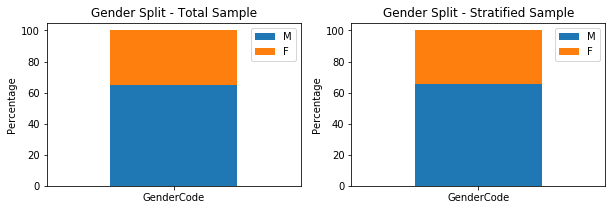

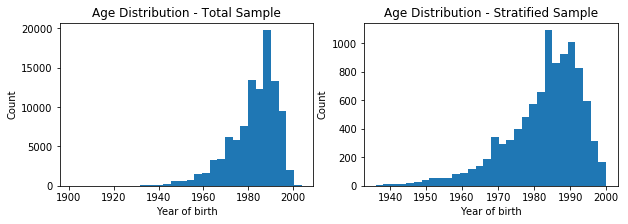

In [11]:
# Check gender split for main sample & sub sample


f1 = plt.figure(figsize=(10,3))
# total sample

# only keep male or female, drop anything uncoded
ValidGender = (dfUsers["GenderCode"]  == "M") | (dfUsers["GenderCode"] == "F")
dfGender=pd.DataFrame(dfUsers.loc[ValidGender, "GenderCode"])
counts = dfGender.apply(lambda x: 100*(x.value_counts() / len(x))).transpose()
ax1 = f1.add_subplot(121)
ax1.set_title("Gender Split - Total Sample")
ax1.set_ylabel("Percentage")
counts.plot(ax=ax1,kind='bar',stacked=True, rot=0)

# sub sample
ValidGenderSub = (dfUsersSubSample["GenderCode"]  == "M") | (dfUsersSubSample["GenderCode"] == "F")
dfGender=pd.DataFrame(dfUsersSubSample.loc[ValidGenderSub, "GenderCode"])
counts = dfGender.apply(lambda x: 100*(x.value_counts() / len(x))).transpose()
ax2 = f1.add_subplot(122)
ax2.set_title("Gender Split - Stratified Sample")
ax2.set_ylabel("Percentage")
counts.plot(ax=ax2,kind='bar',stacked=True, rot=0)

# Check age distribution
f2 = plt.figure(figsize=(10,3))
ax3 = f2.add_subplot(121)
ax4 = f2.add_subplot(122)

# only keep ageofbirth > 1900 & older than 10
ValidYears = (dfUsers["YearOfBirth"]>1900) & (dfUsers["YearOfBirth"]<2008)
ax3.hist(dfUsers["YearOfBirth"][ValidYears],bins=30)
ax3.set_title("Age Distribution - Total Sample")
ax3.set_xlabel("Year of birth")
ax3.set_ylabel("Count")

ValidYearsSub = (dfUsersSubSample["YearOfBirth"]>1900) & (dfUsersSubSample["YearOfBirth"]<2008)
ax4.hist(dfUsersSubSample["YearOfBirth"][ValidYearsSub],bins=30)
ax4.set_title("Age Distribution - Stratified Sample")
ax4.set_xlabel("Year of birth")
ax4.set_ylabel("Count")

# Having filtered out non gender and ages between 1900 & 2000 lets double check whats left
ValidUsers = ValidGenderSub & ValidYearsSub
print("\nThere are %5d valid cases out of %5d" % (sum(ValidUsers), len(ValidUsers)))

plt.show()

<p><font color='blue'>Gender: Sub sample has slightly different profile. Nat rep is 51/49 so panel is skewed towards male so fact sub sample reduces slightly probably shouldnt have a big impact</p>

<p>Age: Distribution of Year of Birth looks broadly similar</p>

<p>In conclusion, this sampling approach appears to have achieved the target</font>

Now need to go back to SQL to get a reduced set of accounts and transactions, a summary of the steps taken are:
</p>
<ul>
    <li>Export list of userids</li>
    <li>Import list of userids into SQL</li>
    <li>Match Accounts &amp; Transactions, export to <i>name</i>SubSample.txt</li>
</ul>

After completing the steps in the MSSQL, the results are 4 data sets:
<ul>
    <li>Users</li>
    <li>Accounts</li>
    <li>Deposits</li>
    <li>Spend</li>
</ul>

In [12]:
# File that is pushed to MSSQL, 
dfUsersSubSample["UserSID"].to_csv("data\\Users_Sample_Ids.csv",index=False)

# Data Investigations

Now that I have the sample that is to be used, I now need to investigate the data. The investigations include reviewing the basic statistics, so min, max. I also need to review the quantiles which will be an early indicator of distribution. Ultimately I will run histograms and potentially QQPlots to determine the nature of he distributions.

First here are is a reminder of the data sets and the fields within in each data set.

### Users

The users hold the main demographic data including, gender, age &amp; region

<ul>
    <li>UserId</li>
    <li>Gender</li>
    <li>Age</li>
    <li>Region</li>
</ul>

Caution must be taken in assuming that these are accurate as accounts can be joint so may be representative of an individual in a household rather than a household with just this individual

Users: data\\UsersSubSample.txt<br/>
<strong>Fields</strong>: UserSID, RegionName, GenderCode, YearOfBirth, HomePostCode, MosaicGroupCode

### Accounts

As per Users very little account level features. Key here is to merge into users in order to determine the number of accounts held by an individual user

<ul>
    <li>Number of accounts held</li>
    <li>Account Type</li>
</ul>

Accounts: data\\AccountsSubSample.txt<br/>
<strong>Fields</strong>: AccountSID, UserSID, AccountType

### Transactions

The Transactions include both Deposits and Spend. I will take separate these out and investigate individually. It makes sense to group Deposits and also Spend but not to cross over.

Deposits can offer up more information than is obvious as I should be able to determine regular payments that could potentially represent Salary and other regular payments of a User which, is a indicator of household income levels.


Spend: data\\SpendSubSample.txt<br/>
<strong>Fields</strong>: TransactionSID, AccountSID, TransactionDateOriginal, TransactionDescriptionOriginal, TagName, Amount

Deposits: data\\DepositsSubSample.txt<br/>
<strong>Fields</strong>:TransactionSID, AccountSID, TransactionDateOriginal, TransactionDescriptionOriginal, TagName, Amount


## Deposits

I will start with the lowest level first i.e. the transactions, of which there are two types, deposits and spend. Lets start with deposits.

Load Deposits and run basic information to get an understanding of the data

In [13]:
# read in the transactions
dfDeposits = pd.read_csv(DATA_DIR + "DepositsSubSample.txt", \
   sep="\t", \
   header=None, \
   names=["UserSID", "TransactionSID", "AccountSID", "TransactionDate","TransactionDescription", "TagName","Amount"], \
   dtype={"UserSID":"int64", "TransactionSID":"int64", "AccountSID":"int64", "TagName":"category", "Amount":"float"}, \
   parse_dates=["TransactionDate"])

# To enable encapsulation of code running set month here, month is count from base date of jan 2017 1 so as to get
# unique value over period
dfDeposits["Month"]  = dfDeposits["TransactionDate"].apply(lambda x: x.month + 12*(x.year-2017))

# Basic descriptors
print("\n\nDeposits top 5 rows")
print("--------------------")
display(dfDeposits.head())
print("\n\nDeposits (numerical) statistics")
print("---------------------------------")
display(dfDeposits.describe())
print("\n\nCheck for missing\n")
print("-------------------")
display(dfDeposits.isnull().sum(axis=0))

# check the values &amp; counts for categorical variables
print("\n\nFrequency percentages for Tag Name")
print("------------------------------------")
dfDepositPercentages = dfDeposits.TagName.value_counts(normalize=True)
print("Deposit Frequencies - Original")
display(dfDepositPercentages)



Deposits top 5 rows
--------------------


,UserSID,TransactionSID,AccountSID,TransactionDate,TransactionDescription,TagName,Amount,Month
0,36895,155010784,5022,2017-06-05,<mdbremoved>,No Tag,88.33,6
1,36895,156392696,5022,2017-06-12,<mdbremoved>,No Tag,600.00,6
2,36895,159019399,5022,2017-06-26,<mdbremoved>,No Tag,2500.00,6
3,36895,162298592,5022,2017-07-11,<mdbremoved>,No Tag,600.00,7
4,36895,163700131,5022,2017-07-18,xxxxxx xxxx5909 internal transfer,Transfers,67.50,7




Deposits (numerical) statistics
---------------------------------


,UserSID,TransactionSID,AccountSID,Amount,Month
count,1.379824e+06,1.379824e+06,1.379824e+06,1.379824e+06,1.379824e+06
mean,9.432541e+04,2.178014e+08,4.006097e+05,6.195492e+02,1.172255e+01
std,5.323078e+04,3.500169e+07,2.246033e+05,5.455555e+03,3.679734e+00
min,8.000000e+00,1.540913e+08,4.500000e+01,1.000000e-02,6.000000e+00
25%,4.860500e+04,1.900206e+08,2.050560e+05,1.700000e+01,9.000000e+00
50%,9.625500e+04,2.195644e+08,4.166850e+05,8.000000e+01,1.200000e+01
75%,1.514350e+05,2.477185e+08,6.199840e+05,3.500000e+02,1.500000e+01
max,1.768700e+05,2.758167e+08,7.393250e+05,1.761152e+06,1.900000e+01




Check for missing

-------------------


UserSID                   0
TransactionSID            0
AccountSID                0
TransactionDate           0
TransactionDescription    0
TagName                   0
Amount                    0
Month                     0
dtype: int64



Frequency percentages for Tag Name
------------------------------------
Deposit Frequencies - Original


No Tag                            5.426467e-01
Transfers                         1.349114e-01
Credit Card                       6.786518e-02
Interest income                   3.844621e-02
Rewards/cashback                  2.382405e-02
Enjoyment                         2.024823e-02
Family benefits                   1.961844e-02
Salary or Wages (Main)            1.666517e-02
Refunded purchase                 1.614481e-02
Current account                   1.463737e-02
Clothes - Everyday or Work        1.133550e-02
Interest charges                  1.127535e-02
Cash                              1.064194e-02
Food, Groceries, Household        7.742292e-03
Rental income (whole property)    7.711128e-03
Benefits                          7.350213e-03
Gambling                          5.415908e-03
Savings (general)                 4.923816e-03
Expenses                          3.155475e-03
Public Transport                  2.878628e-03
Home                              2.798183e-03
Unsecured loa

The frequencies for Deposits show that:

<ul>
    <li>No Tag i.e. the data provider was unable to assign a category for the deposit, which accounts for approx. <strong>55%</strong> of all cases</li>
    <li>There are a number of Tags that have a negligible amount of data, so with a view to reduce the number of overall features, decision made to exclude very low incidence (NOTE: Manual review of Tags to confirm no salient Tags removed)</li>
    <li>There are a number of Tags that indicate refunds, these should be removed as they are arbitrary deposits</li>
    <li>There are a number of tags that can be collapsed i.e. the data provider assigned different tags to same event</li>
</ul>

In [14]:
#Push out to Excel and manually review.
dfDepositPercentages.to_csv(REPORTS_DIR + "DepositPercentages.csv")

### TagNames being removed due to being low incidence or refunds

The table below allows you scroll through to see which tags have been removed. It will be clear that they are very low incidence or refunded purchases.

In [15]:
display(IFrame("files/DepositTagsToRemove.html", width=700, height=400))

In [16]:
# Drop from dfDeposits
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Refunded purchase"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Clothes - Everyday or Work"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Food, Groceries, Household"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Unsecured loan funds"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Public Transport"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Energy (Gas, Elec, Other)"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Tax Payment"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Entertainment, TV, Media"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Home DIY or Repairs"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Mobile"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Dining or Going Out"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Business Expenses"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Health insurance"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Payday Loan"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Flights"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Insurance"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Transport"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Books / Magazines / Newspapers"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Lunch or Snacks"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="DIY"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Water"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Music"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Personal Electronics"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="TV / Movies Package"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Paypal account"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Appearance"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Shoes"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Phone or Internet"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Gifts or Presents"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="TV Licence"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Vehicle insurance"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Service / Parts / Repairs"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Holidays"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Holiday"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Hotel/B&B"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Dental insurance"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Fuel"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Cycling"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Broadband"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Eye care"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Alcohol"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Child - Clothes"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Breakdown cover"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Taxis or Vehicle Hire"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Sports Equipment"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Media bundle"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Phone (landline)"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Pet - Everyday or Food"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Beauty products"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Home insurance"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Vehicle hire"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Software"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Hairdressing, Health, Other"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Appliances or Electrical"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Clothes - Designer or Other"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Investments or Shares"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Gym Membership"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Pet Insurance"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Hire Purchase"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Student Loan funds"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Bursary"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Dining and drinking"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Electrical equipment"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Vehicle"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Take-away"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Furniture"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Child - Toys, Clubs or Other"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Taxi"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Medical, Dental, Eye Care"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Jewellery"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Stationery"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Art Supplies"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Device rental"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Cinema"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="One-off or Other Payment"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Life insurance"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Home appliance insurance"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Unsecured loan repayment"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Rental income (room)"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Web hosting"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Mobile phone insurance"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Bills"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Donation to organisation"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Hobbies or Activities"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Rent"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Flowers"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Garden"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Child - Everyday or Childcare"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Bond income"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Photography"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Accessories"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Toys"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Parking or Tolls"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Hairdressing"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Pension or Investments"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Parking"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="One-off or Other"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Contents or Other Insurance"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Irregular Income or Gifts"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Furniture, Furnishing, Gardens"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Road charges"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Driving Lessons"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Pet - Toys, Training, Other"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Payday loan funds"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Personal Loan"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Dry cleaning and laundry"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Mortgage or Rent"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Income insurance"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Stationery & consumables"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Store card repayment"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Tax rebate"].index,inplace=True)
dfDeposits.drop(dfDeposits[dfDeposits.TagName =="Lighting"].index,inplace=True)

### TagNames being merged

The following table shows the tag names that appear to overlap another tag name and as such should be collapsed into a single category.

In [17]:
display(IFrame("files/DepositTagsToMerge.html", width=700, height=400))

In [18]:
dfDeposits.loc[dfDeposits.TagName =="Bank charges","TagName"]="Interest income"
dfDeposits.loc[dfDeposits.TagName =="Banking Charges","TagName"]="Interest income"
dfDeposits.loc[dfDeposits.TagName =="Current account","TagName"]="Interest income"
dfDeposits.loc[dfDeposits.TagName =="Family benefits","TagName"]="Benefits"
dfDeposits.loc[dfDeposits.TagName =="Gambling","TagName"]="Enjoyment"
dfDeposits.loc[dfDeposits.TagName =="Games and gaming","TagName"]="Enjoyment"
dfDeposits.loc[dfDeposits.TagName =="Home","TagName"]="Rental income (whole property)"
dfDeposits.loc[dfDeposits.TagName =="Interest charges","TagName"]="Interest income"
dfDeposits.loc[dfDeposits.TagName =="Other benefits","TagName"]="Benefits"
dfDeposits.loc[dfDeposits.TagName =="Salary (secondary)","TagName"]="No Tag"
dfDeposits.loc[dfDeposits.TagName =="Salary or Wages (Main)","TagName"]="No Tag"
dfDeposits.loc[dfDeposits.TagName =="Savings (general)","TagName"]="Interest income"
dfDeposits.loc[dfDeposits.TagName =="Winnings","TagName"]="Enjoyment"
dfDeposits.loc[dfDeposits.TagName =="Pension","TagName"]="Work pension"

### TagNames to be kept

The table below shows the primary tags that will form he basis for the Deposit features.

In [19]:
display(IFrame("files/DepositTagsToKeep.html", width=700, height=400))

Re-run frequencies, double check TagNames and percentages are as expected
<br/>
<br/>
<i>NOTE: Due to removal of number of categories % have increased in proportion which is why merge+keep does not equal final %</i>

In [20]:
dfDeposits.TagName.cat.remove_unused_categories(inplace=True)
dfDepositPercentages = dfDeposits.TagName.value_counts(normalize=True)
print("\nDeposit Frequencies - Original")
print("-------------------------------")
display(dfDepositPercentages)


Deposit Frequencies - Original
-------------------------------


No Tag                            0.595792
Transfers                         0.143703
Interest income                   0.075386
Credit Card                       0.072288
Benefits                          0.030065
Enjoyment                         0.028916
Rewards/cashback                  0.025377
Cash                              0.011335
Rental income (whole property)    0.011194
Expenses                          0.003361
Mortgage release                  0.001541
Work pension                      0.001041
Name: TagName, dtype: float64

<p>I need to flatten the Deposits data to the User level before joining to make available as features.</p>

<p>There are some choices here, I need to determine what aggregate function should be used.</p>
    
<p>Remember that each user has different periods available in the data set. So user 1 may have data from 1 June 2017 - 1 Dec 2018 whereas User 2 may have data from Oct 2017 to Mar 2018.</p>

<p><font color='blue'>I could use sum but as there are varying periods per users then this would not be an apples v apples comparison. The only option is to choose a fixed time period to average over. Monthly seems appropriate as there are a lots of events that occur monthly, including salary, mortgage and utility bills.</font></p>

In [21]:
dfDepositsGrouped=dfDeposits.groupby(["UserSID","TagName"])["Amount"].sum()
Mnths = dfDeposits.groupby(["UserSID","Month"])["Month"].count().unstack().count(axis=1)
dfDepositsFlat = dfDepositsGrouped.unstack(-1,0)

# Rename columns to avoid conflict with Spend data
dfDepositsFlat.rename(columns = {"Benefits":"BenefitsIn", \
                                 "Cash":"CashIn", \
                                 "Credit Card":"CreditCardIn", \
                                 "Enjoyment":"WinningsIn", \
                                 "Expenses":"ExpensesIn", \
                                 "Interest income":"InterestIn", \
                                 "Mortgage release":"MortgageIn", \
                                 "No Tag":"NoTagIn", \
                                 "Rental income (whole property)":"RentIn", \
                                 "Rewards/cashback":"RewardsIn", \
                                 "Transfers":"TransfersIn", \
                                 "Work pension":"PensionIn"}, inplace=True)

dfDepositsFlat = dfDepositsFlat.div(Mnths,axis='index')
display(dfDepositsFlat.head())

TagName,BenefitsIn,CashIn,CreditCardIn,WinningsIn,ExpensesIn,InterestIn,MortgageIn,NoTagIn,RentIn,RewardsIn,TransfersIn,PensionIn
UserSID,,,,,,,,,,,,
8,0.0,1000.0,0.00,0.000000,0.0,0.158000,0.0,9170.554000,0.0,0.0,1157.674,0.0
15,101.2,0.0,0.00,34.091111,0.0,0.156667,0.0,5312.424444,0.0,0.0,4.460,0.0
17,0.0,0.0,9.86,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000,0.0
25,0.0,0.0,2458.85,5.769231,0.0,19.230769,0.0,12497.216154,0.0,0.0,0.000,0.0
66,0.0,0.0,0.00,0.000000,0.0,0.000000,0.0,1.330000,0.0,0.0,0.000,0.0


### Unclassified Deposits &amp; Feature Engineering

A key feature that would help determine household composition and segment is the income. On review of the data the data provider does not appear to have been able to successfully tag salary as it accounts for less than 2% of deposits (hence the decision to merge into "No Tag"). My approach is to try to identify regular deposits falling into common salary ranges being regularly paid in on a monthly and weekly basis.This is to be carried out at the user level as opposed to account level.

Below is a function that aims to capture the regular payments that fall into standard salary brackets.

In [22]:
def getSalaryBrackets(tempDeposits):

    # Use a threshold check to determine the number of 
    # individual salaries in the result
    def thresholdCheck(a):
        if a > 3.2:
            return 4
        elif a > 2.4:
            return 3
        elif a > 1.6:
            return 2
        elif a > 0.8:
            return 1
        else:
            return 0

    # set up for use later
    vfunc = np.vectorize(thresholdCheck)

    # First off need to determine start and end of transaction dates (in months based on Jan 2017 = 1 to Dec 2018 = 24
    conseqMonths = max(tempDeposits["Month"]) - min(tempDeposits["Month"])
    totalMonths = len(tempDeposits["Month"].value_counts())-1
    start_month = min(tempDeposits["Month"])
    tMonths = tempDeposits["Month"] - start_month - 1

    # Now need to do the same for weeks for those who are paid weekly .. using Sunday as week start
    dtFirstMonday= min(tempDeposits["TransactionDate"]) - timedelta(days=min(tempDeposits["TransactionDate"]).weekday())
    # Now need to get the last sunday going backwards + 6 days which should take us up to the next saturday
    dtLastSunday = max(tempDeposits["TransactionDate"]) - timedelta(days=max(tempDeposits["TransactionDate"]).weekday()) + timedelta(days=6)
    # Divide days diff by 7 should be a whole number and give conseq weeks
    conseqWeeks = int(((dtLastSunday-dtFirstMonday).days+1) / 7)+1
    tWeeks = tempDeposits["TransactionDate"].map(lambda x: int(((x - timedelta(days=x.weekday()) + timedelta(days=6)-dtFirstMonday).days+1) / 7))


    monthlyResults = np.zeros((conseqMonths,4))
    weeklyResults = np.zeros((conseqWeeks,4))

    # check for breaks in service
    if conseqMonths != totalMonths:
        #print("Returning none due to break in months")
        return [-1, 0, 0, 0]

    # only check for anything more than 6 months
    if totalMonths < 6:
        #print("Returning none due to break in months")
        return [-2, 0, 0, 0]

    # have to assume that salary is:
    # a) regular
    # b) the largest values in the account
    # c) lets sense check regular salary brackets
    # £10K = £817 / £20K = £1,415 / £30K = £1,981 / £40K = £2,548
    # £50K = £3,084 / £60K = £3,567 / £70K = £4,051 / £80K = £4,534
    # £90K = £5,017 / £100K = £5,501

    SalaryBrackets = ["Not Salary","£10k-£40k","£41k-£80k","£81k+"]


    #817
    tSalaryMonth = pd.cut(tempDeposits["Amount"], \
                    [0,817,2548,4534,50000000], \
                    labels=SalaryBrackets)


    tSalaryWeek = pd.cut(tempDeposits["Amount"], \
                    np.divide([0,817,2548,4534,(50000000*4.5)+1],4.5), \
                    labels=SalaryBrackets)

    # Merge back into results
    combinedDeposits = pd.concat([tempDeposits, \
                            pd.DataFrame(tMonths), \
                            pd.DataFrame(tWeeks), \
                            pd.DataFrame(tSalaryMonth), \
                            pd.DataFrame(tSalaryWeek)], \
                            axis=1)

    # reset columns
    combinedDeposits.head()
    combinedDeposits.columns=["UserSID", "TransactionSID", "AccountSID", "TransactionDate", \
                            "TransactionDescription", "TagName","Amount", \
                            "RealMonth","Month", "Week", "MonthlySalaryBracket", \
                            "WeeklySalaryBracket"]

    # Then it has to appear in each month to qualify
    # Attach back to original dataframe loop over putting 1 into 
    for rowindex,row in combinedDeposits.iterrows():
        if row["MonthlySalaryBracket"] != "Not Salary":
            isal = SalaryBrackets.index(row["MonthlySalaryBracket"])
            monthlyResults[row["Month"],isal] = monthlyResults[row["Month"],isal] + 1


        if row["WeeklySalaryBracket"] != "Not Salary":
            x = row["TransactionDate"]
            isal = SalaryBrackets.index(row["WeeklySalaryBracket"])
            weeklyResults[row["Week"],isal] = weeklyResults[row["Week"],isal] + 1

    return np.add(vfunc(np.mean(monthlyResults,axis=0)), vfunc(np.mean(weeklyResults,axis=0)))

<p>Now that the function has been created, I need to isolate each user and apply the function to all the transactions for that user. The code below does that.</p>

<p><font color='red'>Warning: This takes up to 30 mins to run on a domestic laptop</font></p>

In [23]:
# iterate over each user extract all No Tag Deposits, and return Salary info, push into a final UserSalary array
Users = dfDeposits["UserSID"].unique()
UserSalaries = np.zeros((len(Users),4))

idx = 0;
for uid in Users:
    tempDeposits = dfDeposits[(dfDeposits["UserSID"]==uid)&(dfDeposits["TagName"]=="No Tag")]        
    #if (idx%100 == 0):
    #     print(idx)

    if len(tempDeposits)>0:        
           results = getSalaryBrackets(tempDeposits)
           UserSalaries[idx] = results

    idx=idx+1;

<p>Attach UserSID to the salary brackets in preparation for merging later on.</p>

<p><font color='red'>NOTE: I started with the salary ranges defined within the function but collapsed to broader categories as the results were not very impressive. I also played with the threshold in order to optimize results.</font></p>

In [24]:
dfUserSalaries = pd.concat([pd.DataFrame(Users),pd.DataFrame(UserSalaries)],axis=1)
dfUserSalaries.columns=["UserSID","Not Salary","£10k-£40k","£41k-£80k","£81k+"]

display(dfUserSalaries.sort_values("UserSID").head())

,UserSID,Not Salary,£10k-£40k,£41k-£80k,£81k+
4,8,0.0,2.0,1.0,0.0
5153,15,0.0,1.0,1.0,0.0
5885,17,0.0,0.0,0.0,0.0
5182,25,0.0,0.0,1.0,0.0
998,66,-2.0,0.0,0.0,0.0


In [25]:
dfUserSalaries["Total"] = dfUserSalaries[["£10k-£40k","£41k-£80k","£81k+"]].sum(axis=1)
print(dfUserSalaries.head())


print("\n\nPercentage of Transactions Flagged as Regular Income\n")
print(dfUserSalaries["Total"].value_counts(normalize=True)) # large number without salaried income

print("\n\nNumber of ""Not Salary"" cases that fail based on Non consequecutive months(-1) or less than 6 months (-2)\n")
print(dfUserSalaries["Not Salary"].value_counts())


   UserSID  Not Salary  £10k-£40k  £41k-£80k  £81k+  Total
0    36895         0.0        0.0        0.0    1.0    1.0
1    63602         0.0        2.0        0.0    0.0    2.0
2    34968         0.0        0.0        0.0    0.0    0.0
3    25270         0.0        1.0        0.0    0.0    1.0
4        8         0.0        2.0        1.0    0.0    3.0


Percentage of Transactions Flagged as Regular Income

0.0     0.444136
1.0     0.337860
2.0     0.108642
3.0     0.045988
4.0     0.021605
5.0     0.015741
6.0     0.008848
7.0     0.006893
8.0     0.003601
9.0     0.002366
10.0    0.001132
12.0    0.000823
13.0    0.000617
15.0    0.000412
17.0    0.000309
11.0    0.000309
20.0    0.000309
14.0    0.000206
22.0    0.000103
18.0    0.000103
Name: Total, dtype: float64


Number of Not Salary cases that fail based on Non consequecutive months(-1) or less than 6 months (-2)

 0.0    7448
-1.0    1185
-2.0    1087
Name: Not Salary, dtype: int64


<font color='blue'>The very high percentage of zeros would indicate that this has not been as successful as hoped. After reviewing and refining algorithm based on errors, i think this is as far as I can take it. The cases where there are very high numbers of regular incomes i.e. greater than 6 need to be reviewed to see if these are outliers that need may point to data collection issues. Depending on the results of the clustering of the Deposits Tags &amp; Spend Tags, I will make a call as to whether to include or not as part of the clustering</font>

## Spend

Load the data, run summaries and TagName frequencies for review

In [26]:
dfSpends = pd.read_csv(DATA_DIR + "SpendSubSample.txt", \
   sep="\t", \
   header=None, \
   names=["UserSID", "TransactionSID", "AccountSID", "TransactionDate","TransactionDescription", "TagName","Amount"], \
   dtype={"UserSID":"int64", "TransactionSID":"int64", "AccountSID":"int64", "TagName":"category", "Amount":"float"}, \
   parse_dates=["TransactionDate"])

# Add month here so as to enable encapsualtion of code running, as we are running over multiple years use base date as month 1
# then add to get unique months

dfSpends["Month"]  = dfSpends["TransactionDate"].apply(lambda x: x.month + 12*(x.year-2017))

# Basic descriptors
print("\nAccounts top 5 rows")
print("---------------------")
display(dfSpends.sort_values("UserSID").head())
print("\nAccounts (numerical) statistics")
print("---------------------------------")
display(dfSpends.describe())
print("\nCheck for missing")
print("-------------------")
display(dfSpends.isnull().sum(axis=0))

dfSpendsPercentages = dfSpends.TagName.value_counts(normalize=True)
print("\nDeposit Frequencies - Original")
print("-------------------------------")
display(dfSpendsPercentages)

# push to csv for manual review
dfSpendsPercentages.to_csv(REPORTS_DIR + "SpendPercentages.csv")


Accounts top 5 rows
---------------------


,UserSID,TransactionSID,AccountSID,TransactionDate,TransactionDescription,TagName,Amount,Month
1960778,8,162903370,4798,2017-07-10,parentpay e-com r debit card ending: 3619 tr...,Child - Everyday or Childcare,-59.00,7
1897,8,155192614,5227,2017-06-01,to a/c xxxx3640 call ref.no. 0000 to a/c xxx...,Transfers,-500.00,6
1898,8,155193579,5227,2017-06-01,selby district cou type: direct debit - d/d,Council Tax,-167.00,6
1899,8,155416346,5227,2017-06-02,www.nikestore.com debit card ending: 8426 tr...,Clothes - Everyday or Work,-96.00,6
1900,8,155911248,5227,2017-06-05,itunes.com/bill debit card ending: 8426 tran...,"Entertainment, TV, Media",-5.99,6



Accounts (numerical) statistics
---------------------------------


,UserSID,TransactionSID,AccountSID,Amount,Month
count,8.131282e+06,8.131282e+06,8.131282e+06,8.131282e+06,8.131282e+06
mean,9.509013e+04,2.179642e+08,4.003321e+05,-1.039550e+02,1.173635e+01
std,5.336871e+04,3.508397e+07,2.224574e+05,1.841906e+03,3.685156e+00
min,8.000000e+00,1.541248e+08,4.500000e+01,-1.000000e+06,6.000000e+00
25%,4.887800e+04,1.901595e+08,2.092560e+05,-3.900000e+01,9.000000e+00
50%,9.799900e+04,2.194226e+08,4.143400e+05,-1.318000e+01,1.200000e+01
75%,1.515850e+05,2.483704e+08,6.166670e+05,-5.440000e+00,1.500000e+01
max,1.768700e+05,2.758167e+08,7.393250e+05,-1.000000e-02,1.900000e+01



Check for missing
-------------------


UserSID                   0
TransactionSID            0
AccountSID                0
TransactionDate           0
TransactionDescription    0
TagName                   0
Amount                    0
Month                     0
dtype: int64


Deposit Frequencies - Original
-------------------------------


No Tag                            1.874584e-01
Food, Groceries, Household        1.570804e-01
Enjoyment                         7.852599e-02
Transfers                         7.495841e-02
Lunch or Snacks                   4.876168e-02
Cash                              4.129853e-02
Public Transport                  3.911031e-02
Dining or Going Out               3.858924e-02
Bank charges                      2.622391e-02
Fuel                              2.300830e-02
Entertainment, TV, Media          1.792153e-02
Clothes - Everyday or Work        1.779658e-02
Credit Card                       1.755406e-02
Mobile                            1.567760e-02
Taxi                              1.313741e-02
Home                              1.186603e-02
Gambling                          9.529371e-03
Appearance                        8.741672e-03
Insurance                         8.013988e-03
Energy (Gas, Elec, Other)         7.164307e-03
Take-away                         6.792287e-03
Books / Magaz

Reviewing the Spend and percentages, it makes sense to collapse each of the Tags into broader categories that would represent major groups of major spending but at the same time provide rich enough information to be able to segment the users.

This is necessary as this is a subset of the sample and is likely to represent a subsample of transactions so without grouping we will have real data that hasn't been part of the training data; the implication being that any models trained will need to be on data that is consistent with the wider sample. This enables this, additional tagnames should fall into these major groups.


### Recoding of TagNames to GroupedTag

In [27]:
display(IFrame("files/SpendRecoding.html", width=700, height=400))

In [28]:
# Set the grouped tag
dfSpends.loc[dfSpends["TagName"]=="No Tag","GroupedTag"]="No Tag"
dfSpends.loc[dfSpends["TagName"]=="Food, Groceries, Household","GroupedTag"]="Food"
dfSpends.loc[dfSpends["TagName"]=="Enjoyment","GroupedTag"]="Entertainment"
dfSpends.loc[dfSpends["TagName"]=="Transfers","GroupedTag"]="Internal"
dfSpends.loc[dfSpends["TagName"]=="Lunch or Snacks","GroupedTag"]="Food"
dfSpends.loc[dfSpends["TagName"]=="Cash","GroupedTag"]="Cash"
dfSpends.loc[dfSpends["TagName"]=="Public Transport","GroupedTag"]="Travel"
dfSpends.loc[dfSpends["TagName"]=="Dining or Going Out","GroupedTag"]="Entertainment"
dfSpends.loc[dfSpends["TagName"]=="Bank charges","GroupedTag"]="Banking"
dfSpends.loc[dfSpends["TagName"]=="Fuel","GroupedTag"]="Fuel"
dfSpends.loc[dfSpends["TagName"]=="Entertainment, TV, Media","GroupedTag"]="Entertainment"
dfSpends.loc[dfSpends["TagName"]=="Clothes - Everyday or Work","GroupedTag"]="Clothing"
dfSpends.loc[dfSpends["TagName"]=="Credit Card","GroupedTag"]="Internal"
dfSpends.loc[dfSpends["TagName"]=="Mobile","GroupedTag"]="Bills"
dfSpends.loc[dfSpends["TagName"]=="Taxi","GroupedTag"]="Travel"
dfSpends.loc[dfSpends["TagName"]=="Home","GroupedTag"]="Bills"
dfSpends.loc[dfSpends["TagName"]=="Gambling","GroupedTag"]="Entertainment"
dfSpends.loc[dfSpends["TagName"]=="Appearance","GroupedTag"]="Clothing"
dfSpends.loc[dfSpends["TagName"]=="Insurance","GroupedTag"]="Insurance"
dfSpends.loc[dfSpends["TagName"]=="Energy (Gas, Elec, Other)","GroupedTag"]="Bills"
dfSpends.loc[dfSpends["TagName"]=="Take-away","GroupedTag"]="Food"
dfSpends.loc[dfSpends["TagName"]=="Books / Magazines / Newspapers","GroupedTag"]="Goods"
dfSpends.loc[dfSpends["TagName"]=="Gifts or Presents","GroupedTag"]="Goods"
dfSpends.loc[dfSpends["TagName"]=="Parking","GroupedTag"]="Travel"
dfSpends.loc[dfSpends["TagName"]=="Council Tax","GroupedTag"]="Bills"
dfSpends.loc[dfSpends["TagName"]=="Interest charges","GroupedTag"]="Banking"
dfSpends.loc[dfSpends["TagName"]=="Personal Loan","GroupedTag"]="Loans"
dfSpends.loc[dfSpends["TagName"]=="Water","GroupedTag"]="Bills"
dfSpends.loc[dfSpends["TagName"]=="TV Licence","GroupedTag"]="Bills"
dfSpends.loc[dfSpends["TagName"]=="Transport","GroupedTag"]="Travel"
dfSpends.loc[dfSpends["TagName"]=="Banking Charges","GroupedTag"]="Banking"
dfSpends.loc[dfSpends["TagName"]=="Medical, Dental, Eye Care","GroupedTag"]="Medical"
dfSpends.loc[dfSpends["TagName"]=="TV / Movies Package","GroupedTag"]="Entertainment"
dfSpends.loc[dfSpends["TagName"]=="Hotel/B&B","GroupedTag"]="Entertainment"
dfSpends.loc[dfSpends["TagName"]=="Home DIY or Repairs","GroupedTag"]="DIY"
dfSpends.loc[dfSpends["TagName"]=="Dining and drinking","GroupedTag"]="Entertainment"
dfSpends.loc[dfSpends["TagName"]=="One-off or Other","GroupedTag"]="Other"
dfSpends.loc[dfSpends["TagName"]=="Hairdressing, Health, Other","GroupedTag"]="Health"
dfSpends.loc[dfSpends["TagName"]=="Music","GroupedTag"]="Entertainment"
dfSpends.loc[dfSpends["TagName"]=="Games and gaming","GroupedTag"]="Entertainment"
dfSpends.loc[dfSpends["TagName"]=="Gym Membership","GroupedTag"]="Health"
dfSpends.loc[dfSpends["TagName"]=="Flights","GroupedTag"]="Travel"
dfSpends.loc[dfSpends["TagName"]=="Software","GroupedTag"]="Business"
dfSpends.loc[dfSpends["TagName"]=="Hobbies or Activities","GroupedTag"]="Entertainment"
dfSpends.loc[dfSpends["TagName"]=="Life insurance","GroupedTag"]="Insurance"
dfSpends.loc[dfSpends["TagName"]=="Vehicle insurance","GroupedTag"]="Insurance"
dfSpends.loc[dfSpends["TagName"]=="Rent","GroupedTag"]="Housing"
dfSpends.loc[dfSpends["TagName"]=="Pension or Investments","GroupedTag"]="Investments"
dfSpends.loc[dfSpends["TagName"]=="Alcohol","GroupedTag"]="Entertainment"
dfSpends.loc[dfSpends["TagName"]=="Mortgage payment","GroupedTag"]="Housing"
dfSpends.loc[dfSpends["TagName"]=="Saving (general)","GroupedTag"]="Savings"
dfSpends.loc[dfSpends["TagName"]=="Pet Insurance","GroupedTag"]="Insurance"
dfSpends.loc[dfSpends["TagName"]=="Holidays","GroupedTag"]="Holiday"
dfSpends.loc[dfSpends["TagName"]=="Business Expenses","GroupedTag"]="Internal"
dfSpends.loc[dfSpends["TagName"]=="Hire Purchase","GroupedTag"]="Travel"
dfSpends.loc[dfSpends["TagName"]=="DIY","GroupedTag"]="DIY"
dfSpends.loc[dfSpends["TagName"]=="Cinema","GroupedTag"]="Entertainment"
dfSpends.loc[dfSpends["TagName"]=="Personal Electronics","GroupedTag"]="Goods"
dfSpends.loc[dfSpends["TagName"]=="Service / Parts / Repairs","GroupedTag"]="Travel"
dfSpends.loc[dfSpends["TagName"]=="Mobile app","GroupedTag"]="Entertainment"
dfSpends.loc[dfSpends["TagName"]=="Eye care","GroupedTag"]="Health"
dfSpends.loc[dfSpends["TagName"]=="Pet - Everyday or Food","GroupedTag"]="Pets"
dfSpends.loc[dfSpends["TagName"]=="Child - Everyday or Childcare","GroupedTag"]="Childcare"
dfSpends.loc[dfSpends["TagName"]=="Bills","GroupedTag"]="Bills"
dfSpends.loc[dfSpends["TagName"]=="Shoes","GroupedTag"]="Goods"
dfSpends.loc[dfSpends["TagName"]=="Parking or Tolls","GroupedTag"]="Travel"
dfSpends.loc[dfSpends["TagName"]=="One-off or Other Payment","GroupedTag"]="Other"
dfSpends.loc[dfSpends["TagName"]=="Child - Toys, Clubs or Other","GroupedTag"]="Childcare"
dfSpends.loc[dfSpends["TagName"]=="Hairdressing","GroupedTag"]="Health"
dfSpends.loc[dfSpends["TagName"]=="Stationery","GroupedTag"]="Business"
dfSpends.loc[dfSpends["TagName"]=="Clothes - Designer or Other","GroupedTag"]="Goods"
dfSpends.loc[dfSpends["TagName"]=="Concert & Theatre","GroupedTag"]="Entertainment"
dfSpends.loc[dfSpends["TagName"]=="Home insurance","GroupedTag"]="Insurance"
dfSpends.loc[dfSpends["TagName"]=="Beauty products","GroupedTag"]="Health"
dfSpends.loc[dfSpends["TagName"]=="Broadband","GroupedTag"]="Bills"
dfSpends.loc[dfSpends["TagName"]=="Payday Loan","GroupedTag"]="Loans"
dfSpends.loc[dfSpends["TagName"]=="Health insurance","GroupedTag"]="Insurance"
dfSpends.loc[dfSpends["TagName"]=="Appliances or Electrical","GroupedTag"]="Goods"
dfSpends.loc[dfSpends["TagName"]=="Tax Payment","GroupedTag"]="Bills"
dfSpends.loc[dfSpends["TagName"]=="Mortgage or Rent","GroupedTag"]="Housing"
dfSpends.loc[dfSpends["TagName"]=="Road charges","GroupedTag"]="Travel"
dfSpends.loc[dfSpends["TagName"]=="Garden","GroupedTag"]="DIY"
dfSpends.loc[dfSpends["TagName"]=="Financial - other","GroupedTag"]="Banking"
dfSpends.loc[dfSpends["TagName"]=="Cycling","GroupedTag"]="Entertainment"
dfSpends.loc[dfSpends["TagName"]=="Web hosting","GroupedTag"]="Business"
dfSpends.loc[dfSpends["TagName"]=="Home appliance insurance","GroupedTag"]="Insurance"
dfSpends.loc[dfSpends["TagName"]=="Contents or Other Insurance","GroupedTag"]="Insurance"
dfSpends.loc[dfSpends["TagName"]=="Donation to organisation","GroupedTag"]="Charity"
dfSpends.loc[dfSpends["TagName"]=="Vehicle hire","GroupedTag"]="Travel"
dfSpends.loc[dfSpends["TagName"]=="Memberships","GroupedTag"]="Health"
dfSpends.loc[dfSpends["TagName"]=="Jewellery","GroupedTag"]="Goods"
dfSpends.loc[dfSpends["TagName"]=="Dental treatment","GroupedTag"]="Health"
dfSpends.loc[dfSpends["TagName"]=="ISA","GroupedTag"]="Banking"
dfSpends.loc[dfSpends["TagName"]=="Administration - other","GroupedTag"]="Business"
dfSpends.loc[dfSpends["TagName"]=="Supermarket","GroupedTag"]="Food"
dfSpends.loc[dfSpends["TagName"]=="Sports Equipment","GroupedTag"]="Goods"
dfSpends.loc[dfSpends["TagName"]=="Furniture, Furnishing, Gardens","GroupedTag"]="DIY"
dfSpends.loc[dfSpends["TagName"]=="Museum/exhibition","GroupedTag"]="Entertainment"
dfSpends.loc[dfSpends["TagName"]=="Dental insurance","GroupedTag"]="Insurance"
dfSpends.loc[dfSpends["TagName"]=="Breakdown cover","GroupedTag"]="Bills"
dfSpends.loc[dfSpends["TagName"]=="Photography","GroupedTag"]="Goods"
dfSpends.loc[dfSpends["TagName"]=="Holiday","GroupedTag"]="Holiday"
dfSpends.loc[dfSpends["TagName"]=="Credit card repayment","GroupedTag"]="Banking"
dfSpends.loc[dfSpends["TagName"]=="Pet - Toys, Training, Other","GroupedTag"]="Pets"
dfSpends.loc[dfSpends["TagName"]=="Postage / Shipping","GroupedTag"]="Other"
dfSpends.loc[dfSpends["TagName"]=="Dry cleaning and laundry","GroupedTag"]="Bills"
dfSpends.loc[dfSpends["TagName"]=="Insurance - other","GroupedTag"]="Insurance"
dfSpends.loc[dfSpends["TagName"]=="Gas","GroupedTag"]="Bills"
dfSpends.loc[dfSpends["TagName"]=="Art Supplies","GroupedTag"]="Goods"
dfSpends.loc[dfSpends["TagName"]=="Electricity","GroupedTag"]="Bills"
dfSpends.loc[dfSpends["TagName"]=="Flowers","GroupedTag"]="Goods"
dfSpends.loc[dfSpends["TagName"]=="Phone or Internet","GroupedTag"]="Bills"
dfSpends.loc[dfSpends["TagName"]=="Child - Clothes","GroupedTag"]="Childcare"
dfSpends.loc[dfSpends["TagName"]=="Toys","GroupedTag"]="Goods"
dfSpends.loc[dfSpends["TagName"]=="Salary or Wages (Main)","GroupedTag"]="Business"
dfSpends.loc[dfSpends["TagName"]=="Children - other","GroupedTag"]="Childcare"
dfSpends.loc[dfSpends["TagName"]=="Current account","GroupedTag"]="Banking"
dfSpends.loc[dfSpends["TagName"]=="Repayments","GroupedTag"]="Loans"
dfSpends.loc[dfSpends["TagName"]=="Mobile phone insurance","GroupedTag"]="Insurance"
dfSpends.loc[dfSpends["TagName"]=="General savings","GroupedTag"]="Savings"
dfSpends.loc[dfSpends["TagName"]=="Zoo/theme park","GroupedTag"]="Entertainment"
dfSpends.loc[dfSpends["TagName"]=="Sports Club Membership","GroupedTag"]="Entertainment"
dfSpends.loc[dfSpends["TagName"]=="Sports event","GroupedTag"]="Entertainment"
dfSpends.loc[dfSpends["TagName"]=="Student loan repayment","GroupedTag"]="Bills"
dfSpends.loc[dfSpends["TagName"]=="Furniture","GroupedTag"]="Goods"
dfSpends.loc[dfSpends["TagName"]=="Gas and electricity","GroupedTag"]="Bills"
dfSpends.loc[dfSpends["TagName"]=="Vet","GroupedTag"]="Pets"
dfSpends.loc[dfSpends["TagName"]=="Media bundle","GroupedTag"]="Entertainment"
dfSpends.loc[dfSpends["TagName"]=="Vehicle Running Costs","GroupedTag"]="Travel"
dfSpends.loc[dfSpends["TagName"]=="Course and Tuition Fees","GroupedTag"]="Childcare"
dfSpends.loc[dfSpends["TagName"]=="Driving Lessons","GroupedTag"]="Other"
dfSpends.loc[dfSpends["TagName"]=="Designer clothes","GroupedTag"]="Goods"
dfSpends.loc[dfSpends["TagName"]=="Expenses","GroupedTag"]="Business"
dfSpends.loc[dfSpends["TagName"]=="Legal","GroupedTag"]="Business"
dfSpends.loc[dfSpends["TagName"]=="Taxis or Vehicle Hire","GroupedTag"]="Travel"
dfSpends.loc[dfSpends["TagName"]=="Secured loan repayment","GroupedTag"]="Loans"
dfSpends.loc[dfSpends["TagName"]=="Sharedealing account","GroupedTag"]="Internal"
dfSpends.loc[dfSpends["TagName"]=="Groceries","GroupedTag"]="Food"
dfSpends.loc[dfSpends["TagName"]=="Payment Protection Insurance","GroupedTag"]="Insurance"
dfSpends.loc[dfSpends["TagName"]=="Savings","GroupedTag"]="Savings"
dfSpends.loc[dfSpends["TagName"]=="Hobbies - other","GroupedTag"]="Entertainment"
dfSpends.loc[dfSpends["TagName"]=="Fines","GroupedTag"]="Bills"
dfSpends.loc[dfSpends["TagName"]=="Clothes","GroupedTag"]="Goods"
dfSpends.loc[dfSpends["TagName"]=="Charity - other","GroupedTag"]="Charity"
dfSpends.loc[dfSpends["TagName"]=="Childcare Fees","GroupedTag"]="Childcare"
dfSpends.loc[dfSpends["TagName"]=="Coal/Oil/LPG/other","GroupedTag"]="Bills"
dfSpends.loc[dfSpends["TagName"]=="Store card repayment","GroupedTag"]="Bills"
dfSpends.loc[dfSpends["TagName"]=="Tradesmen fees","GroupedTag"]="DIY"
dfSpends.loc[dfSpends["TagName"]=="Printing","GroupedTag"]="Business"
dfSpends.loc[dfSpends["TagName"]=="Art","GroupedTag"]="Goods"
dfSpends.loc[dfSpends["TagName"]=="School fees","GroupedTag"]="Childcare"
dfSpends.loc[dfSpends["TagName"]=="Social club","GroupedTag"]="Entertainment"
dfSpends.loc[dfSpends["TagName"]=="Spa","GroupedTag"]="Entertainment"
dfSpends.loc[dfSpends["TagName"]=="Car fund","GroupedTag"]="Travel"
dfSpends.loc[dfSpends["TagName"]=="Household - other","GroupedTag"]="Bills"
dfSpends.loc[dfSpends["TagName"]=="Income insurance","GroupedTag"]="Insurance"
dfSpends.loc[dfSpends["TagName"]=="Unsecured loan funds","GroupedTag"]="Loans"
dfSpends.loc[dfSpends["TagName"]=="Personal Care - Other","GroupedTag"]="Health"
dfSpends.loc[dfSpends["TagName"]=="Phone (landline)","GroupedTag"]="Bills"
dfSpends.loc[dfSpends["TagName"]=="Education - other","GroupedTag"]="Childcare"
dfSpends.loc[dfSpends["TagName"]=="Accessories","GroupedTag"]="Goods"
dfSpends.loc[dfSpends["TagName"]=="Device rental","GroupedTag"]="Business"
dfSpends.loc[dfSpends["TagName"]=="Musical Equipment","GroupedTag"]="Goods"
dfSpends.loc[dfSpends["TagName"]=="Lifestyle - other","GroupedTag"]="Entertainment"
dfSpends.loc[dfSpends["TagName"]=="Unsecured loan repayment","GroupedTag"]="Loans"
dfSpends.loc[dfSpends["TagName"]=="Home and garden - other","GroupedTag"]="DIY"
dfSpends.loc[dfSpends["TagName"]=="Vehicle tax","GroupedTag"]="Travel"
dfSpends.loc[dfSpends["TagName"]=="Hobby Club Membership","GroupedTag"]="Entertainment"
dfSpends.loc[dfSpends["TagName"]=="Investment - other","GroupedTag"]="Banking"
dfSpends.loc[dfSpends["TagName"]=="Gifts - other","GroupedTag"]="Goods"
dfSpends.loc[dfSpends["TagName"]=="Other Repayment","GroupedTag"]="Loans"
dfSpends.loc[dfSpends["TagName"]=="Motorbike Insurance","GroupedTag"]="Insurance"
dfSpends.loc[dfSpends["TagName"]=="Medical treatment","GroupedTag"]="Health"
dfSpends.loc[dfSpends["TagName"]=="Investments or Shares","GroupedTag"]="Banking"
dfSpends.loc[dfSpends["TagName"]=="Beauty treatments","GroupedTag"]="Health"
dfSpends.loc[dfSpends["TagName"]=="Physiotherapy","GroupedTag"]="Health"
dfSpends.loc[dfSpends["TagName"]=="Childrens Club fees","GroupedTag"]="Childcare"
dfSpends.loc[dfSpends["TagName"]=="Hobby Supplies","GroupedTag"]="Entertainment"
dfSpends.loc[dfSpends["TagName"]=="Sponsorship","GroupedTag"]="Other"
dfSpends.loc[dfSpends["TagName"]=="Penalty charges","GroupedTag"]="Bills"
dfSpends.loc[dfSpends["TagName"]=="Transport - other","GroupedTag"]="Travel"
dfSpends.loc[dfSpends["TagName"]=="Stationery & consumables","GroupedTag"]="Business"
dfSpends.loc[dfSpends["TagName"]=="Home electronics","GroupedTag"]="Goods"
dfSpends.loc[dfSpends["TagName"]=="Clothes - other","GroupedTag"]="Goods"
dfSpends.loc[dfSpends["TagName"]=="Rewards/cashback","GroupedTag"]="Business"
dfSpends.loc[dfSpends["TagName"]=="Payday loan funds","GroupedTag"]="Loans"
dfSpends.loc[dfSpends["TagName"]=="Lighting","GroupedTag"]="Business"
dfSpends.loc[dfSpends["TagName"]=="Vehicle","GroupedTag"]="Business"
dfSpends.loc[dfSpends["TagName"]=="Pet food","GroupedTag"]="Pets"
dfSpends["GroupedTag"].astype("category")

# now run frequencies on groupedtag column
# check the values &amp; counts for categorical variables
dfGroupedTagPercentages = dfSpends.GroupedTag.value_counts(normalize=True)

print("\nGrouped Tag Frequencies")
print("------------------------")
dfGroupedTagPercentages


Grouped Tag Frequencies
------------------------


Food             0.213118
No Tag           0.187458
Entertainment    0.168986
Internal         0.094036
Travel           0.069762
Bills            0.053719
Cash             0.041299
Banking          0.037254
Clothing         0.026538
Fuel             0.023008
Goods            0.018983
Insurance        0.017557
Health           0.009125
Loans            0.005678
DIY              0.005675
Business         0.004664
Housing          0.004479
Other            0.004273
Medical          0.003855
Childcare        0.002705
Holiday          0.001893
Investments      0.001867
Savings          0.001859
Pets             0.001584
Charity          0.000626
Name: GroupedTag, dtype: float64


Flatten Spend so that it can be attached to Account before joining to User

Identically to Deposits we will need to flatten the Spend data before merging with the User data and as with Deposits we will use Monthly to aggregate to.


In [29]:
dfSpendsGrouped=dfSpends.groupby(["UserSID","GroupedTag"])["Amount"].sum()
Mnths = dfSpends.groupby(["UserSID","Month"])["Month"].count().unstack().count(axis=1)
dfSpendsFlat = dfSpendsGrouped.unstack(-1,0)
dfSpendsFlat = dfSpendsFlat.div(Mnths,axis='index')
dfSpendsFlat.head()

GroupedTag,Banking,Bills,Business,Cash,Charity,Childcare,Clothing,DIY,Entertainment,Food,...,Insurance,Internal,Investments,Loans,Medical,No Tag,Other,Pets,Savings,Travel
UserSID,,,,,,,,,,,,,,,,,,,,,
8,-10.526000,-366.161000,0.000000,-495.337000,-3.906,-198.590000,-185.332000,-23.301000,-344.315000,-711.718000,...,-143.828000,-1666.942000,0.000000,0.000000,-30.681000,-5205.173000,-21.041000,-7.434,0.000000,-36.656000
15,-1.458889,-370.904444,0.000000,-202.400000,0.000,-57.415556,-66.513333,-13.461111,-726.945556,-683.697778,...,-233.491111,-565.380000,-2.228889,-469.942222,0.000000,-1035.866667,-9.637778,0.000,0.000000,-52.066667
25,-212.264615,-197.586923,-0.403846,-136.411538,0.000,0.000000,-136.831538,-0.566923,-736.178462,-152.946154,...,-2.061538,-3321.028462,-3.230769,0.000000,-11.461538,-1900.203077,-12.573077,0.000,-57.692308,-275.254615
110,0.000000,-93.200000,-1.349231,0.000000,0.000,0.000000,-17.693846,-9.143846,-52.617692,0.000000,...,-19.479231,-5384.615385,0.000000,0.000000,0.000000,-59.076923,0.000000,0.000,0.000000,0.000000
172,-53.152308,-71.220769,0.000000,-443.712308,0.000,0.000000,-5.421538,0.000000,-64.260000,-42.154615,...,-12.223846,-1008.141538,0.000000,-288.507692,0.000000,-596.656923,-16.792308,0.000,0.000000,-14.306923


## Accounts

The accounts data does not hold a lot of information, its more of linking table. The one piece of data, account type I have decided not to use as a final feature as there is no sense of distance. I will however, for completeness.

Run basic descriptives for the file and review

There are 4 types of accounts, Current Account, Credit Card, Savings & Other. Potential source of difference between users so flatten out and attach back to account.

Add in Total number of accounts.

In [30]:
dfAccounts = pd.read_csv(DATA_DIR + "AccountsSubSample.txt", \
                        sep='\t', \
                        header=None,
                        names=["AccountSID","UserSID","AccountType"],
                        dtype={"AccountSID":"int32","UserSID":"int32","AccountType":"category"})

# Basic descriptors
print("\nAccounts top 5 rows")
print("--------------------")
display(dfAccounts.head())

print("\nCheck for missing")
print("-------------------")
display(dfAccounts.isnull().sum(axis=0))

# check the values &amp; counts for categorical variables
print("\nFrequency counts for Account Type")
print("----------------------------------")

display(dfAccounts["AccountType"].value_counts())
dfAccs = pd.get_dummies(dfAccounts["AccountType"])
dfAccounts = dfAccounts.join(dfAccs)

dfAccountsGrouped = dfAccounts.groupby("UserSID")["Credit Card","Current","Other","Savings"].sum().reset_index()
dfAccountsGrouped["Total"] = dfAccountsGrouped[["Credit Card","Current","Other","Savings"]].sum(axis=1)
display(dfAccountsGrouped.head())


Accounts top 5 rows
--------------------


,AccountSID,UserSID,AccountType
0,19101,78963,Credit Card
1,19102,63202,Current
2,19103,9548,Savings
3,19104,9548,Current
4,19105,9548,Current



Check for missing
-------------------


AccountSID     0
UserSID        0
AccountType    0
dtype: int64


Frequency counts for Account Type
----------------------------------


Current        22811
Savings        14986
Credit Card    11679
Other           1827
Name: AccountType, dtype: int64

,UserSID,Credit Card,Current,Other,Savings,Total
0,8,1,6,0,0,7
1,15,2,3,0,0,5
2,17,1,1,0,0,2
3,25,3,1,0,0,4
4,66,0,6,0,1,7


## Users

There is no need to flatten the user level data as it is the top level.

I'll review the stats and check for missing.

In [31]:
dfUsers = pd.read_csv(DATA_DIR + "UsersSubSample.txt", \
                      sep="\t", \
                      header=None, \
                      names=["UserSID","RegionName", "GenderCode", "YearOfBirth", "HomePostcode", "MosaicGroupCode"], \
                     dtype={"UserSID":"int32","RegionName":"str", "GenderCode":"str", "YearOfBirth":"int32", "HomePostcode":"str", "MosaicGroupCode":"int32"})

print("\n\nUsers top 5 rows\n")
display(dfUsers.sort_values("UserSID").head())
print("\n\nUsers (numerical) statistics\n")
display(dfUsers.describe())
print("\n\nCheck for missing\n")
display(dfUsers.isnull().sum(axis=0))



Users top 5 rows



,UserSID,RegionName,GenderCode,YearOfBirth,HomePostcode,MosaicGroupCode
0,8,Yorkshire and the Humber,M,1978,DN14 0,7
1,15,West Midlands,F,1984,HR8 1,5
2,17,East Midlands,M,1980,NG5 5,8
3,25,London,M,1980,HA3 0,7
4,66,Scotland,M,1970,PA2 9,7




Users (numerical) statistics



,UserSID,YearOfBirth,MosaicGroupCode
count,9773.000000,9773.000000,9773.000000
mean,92617.628057,1982.803131,7.307480
std,53203.566167,10.539748,4.798829
min,8.000000,1934.000000,0.000000
25%,46437.000000,1977.000000,3.000000
50%,94610.000000,1985.000000,7.000000
75%,149800.000000,1990.000000,11.000000
max,176870.000000,2000.000000,15.000000




Check for missing



UserSID            0
RegionName         0
GenderCode         0
YearOfBirth        0
HomePostcode       0
MosaicGroupCode    0
dtype: int64

## Combine Data

Now we have the following datasets at the UserSID level

<ul>
    <li>dfUsers</li>
    <li>dfAccountsGrouped</li>
    <li>dfSpendsFlat</li>
    <li>dfDepositsFlat</li>
    <li>dfUserSalaries</li>
</ul>    


Combining these will give us a flat data set that we build our model from

In [32]:
dfUsersCombined = dfUsers.merge(dfAccountsGrouped,how='left',on='UserSID',suffixes=["U","A"])
dfUsersCombined = dfUsersCombined.merge(dfDepositsFlat,how='left',on='UserSID',suffixes=["U","D"])
dfUsersCombined = dfUsersCombined.merge(dfSpendsFlat,how='left',on='UserSID',suffixes=["U","D"])
dfUsersCombined = dfUsersCombined.merge(dfUserSalaries,how='left',on='UserSID',suffixes=["U","D"])

print("\nCombined top 5 rows")
print("---------------------")
display(dfUsersCombined.sort_values("UserSID").head())
print("\nAccounts (numerical) statistics")
print("--------------------------------")
display(dfUsersCombined.describe())
print("\n\nCheck for missing")
print("--------------------")
display(dfUsersCombined.isnull().sum(axis=0))



Combined top 5 rows
---------------------


,UserSID,RegionName,GenderCode,YearOfBirth,HomePostcode,MosaicGroupCode,Credit Card,Current,OtherU,SavingsU,...,No Tag,OtherD,Pets,SavingsD,Travel,Not Salary,£10k-£40k,£41k-£80k,£81k+,TotalD
0,8,Yorkshire and the Humber,M,1978,DN14 0,7,1,6,0,0,...,-5205.173000,-21.041000,-7.434,0.000000,-36.656000,0.0,2.0,1.0,0.0,3.0
1,15,West Midlands,F,1984,HR8 1,5,2,3,0,0,...,-1035.866667,-9.637778,0.000,0.000000,-52.066667,0.0,1.0,1.0,0.0,2.0
2,17,East Midlands,M,1980,NG5 5,8,1,1,0,0,...,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0
3,25,London,M,1980,HA3 0,7,3,1,0,0,...,-1900.203077,-12.573077,0.000,-57.692308,-275.254615,0.0,0.0,1.0,0.0,1.0
4,66,Scotland,M,1970,PA2 9,7,0,6,0,1,...,NaN,NaN,NaN,NaN,NaN,-2.0,0.0,0.0,0.0,0.0



Accounts (numerical) statistics
--------------------------------


,UserSID,YearOfBirth,MosaicGroupCode,Credit Card,Current,OtherU,SavingsU,TotalU,BenefitsIn,CashIn,...,No Tag,OtherD,Pets,SavingsD,Travel,Not Salary,£10k-£40k,£41k-£80k,£81k+,TotalD
count,9773.000000,9773.000000,9773.000000,9773.000000,9773.000000,9773.000000,9773.000000,9773.000000,9720.000000,9720.000000,...,9684.000000,9684.000000,9684.000000,9684.000000,9684.000000,9720.000000,9720.000000,9720.000000,9720.000000,9720.000000
mean,92617.628057,1982.803131,7.307480,1.195027,2.334084,0.186944,1.533408,5.249463,46.773623,54.275482,...,-2080.199392,-14.967771,-3.319330,-33.252294,-143.498360,-0.345576,0.790638,0.150309,0.125926,1.066872
std,53203.566167,10.539748,4.798829,1.925290,2.120843,0.763168,2.298274,4.715676,290.886409,393.279117,...,6476.163515,236.498901,14.524794,351.933984,286.441734,0.670718,1.122177,0.436926,0.569112,1.633409
min,8.000000,1934.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,...,-172411.516429,-17675.652000,-578.810000,-20100.000000,-9468.225000,-2.000000,0.000000,0.000000,0.000000,0.000000
25%,46437.000000,1977.000000,3.000000,0.000000,1.000000,0.000000,0.000000,3.000000,0.000000,0.000000,...,-1734.735268,-6.789455,0.000000,0.000000,-174.731769,0.000000,0.000000,0.000000,0.000000,0.000000
50%,94610.000000,1985.000000,7.000000,1.000000,2.000000,0.000000,1.000000,4.000000,0.000000,0.000000,...,-751.210321,-1.185357,0.000000,0.000000,-62.323636,0.000000,0.000000,0.000000,0.000000,1.000000
75%,149800.000000,1990.000000,11.000000,2.000000,3.000000,0.000000,2.000000,6.000000,0.000000,13.076923,...,-278.782348,0.000000,0.000000,0.000000,-17.248036,0.000000,1.000000,0.000000,0.000000,1.000000
max,176870.000000,2000.000000,15.000000,42.000000,34.000000,25.000000,60.000000,102.000000,23721.544286,20994.771429,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,7.000000,8.000000,22.000000




Check for missing
--------------------


UserSID             0
RegionName          0
GenderCode          0
YearOfBirth         0
HomePostcode        0
MosaicGroupCode     0
Credit Card         0
Current             0
OtherU              0
SavingsU            0
TotalU              0
BenefitsIn         53
CashIn             53
CreditCardIn       53
WinningsIn         53
ExpensesIn         53
InterestIn         53
MortgageIn         53
NoTagIn            53
RentIn             53
RewardsIn          53
TransfersIn        53
PensionIn          53
Banking            89
Bills              89
Business           89
Cash               89
Charity            89
Childcare          89
Clothing           89
DIY                89
Entertainment      89
Food               89
Fuel               89
Goods              89
Health             89
Holiday            89
Housing            89
Insurance          89
Internal           89
Investments        89
Loans              89
Medical            89
No Tag             89
OtherD             89
Pets      

<font color='blue'>Reviewing highlights that there are some accounts without deposits and some without spend. These may be data collection errors or potentially processing errors. As we have a large sample of users and the numbers are low, I will remove.</font>

In [33]:
dfUsersCombined.drop(dfUsersCombined[dfUsersCombined["No Tag"].isnull()].index,inplace=True)
dfUsersCombined.drop(dfUsersCombined[dfUsersCombined["BenefitsIn"].isnull()].index,inplace=True)
#dfUsersCombined.info()
# Basic stats
#dfUsersStats = dfUsersCombined.describe()

# Zero counts - anything with very little going on we should consider combining or dropping
dfUserZeros = len(dfUsersCombined) - dfUsersCombined.astype(bool).sum(axis=0)
#dfUserZeros.to_csv(REPORTS_DIR + "zeros.csv")

print("\nCheck for missing")
print("-----------------")
display(dfUsersCombined.isnull().sum(axis=0))

print("\nDouble check shape")
print("-----------------")
display(dfUsersCombined.shape)


Check for missing
-----------------


UserSID            0
RegionName         0
GenderCode         0
YearOfBirth        0
HomePostcode       0
MosaicGroupCode    0
Credit Card        0
Current            0
OtherU             0
SavingsU           0
TotalU             0
BenefitsIn         0
CashIn             0
CreditCardIn       0
WinningsIn         0
ExpensesIn         0
InterestIn         0
MortgageIn         0
NoTagIn            0
RentIn             0
RewardsIn          0
TransfersIn        0
PensionIn          0
Banking            0
Bills              0
Business           0
Cash               0
Charity            0
Childcare          0
Clothing           0
DIY                0
Entertainment      0
Food               0
Fuel               0
Goods              0
Health             0
Holiday            0
Housing            0
Insurance          0
Internal           0
Investments        0
Loans              0
Medical            0
No Tag             0
OtherD             0
Pets               0
SavingsD           0
Travel       


Double check shape
-----------------


(9642, 53)

## Final Data Set


Now there is a final flat data set, review the statistics and distributions to determine whether any scaling or transformations are needed prior to Dimension Reduction and Clustering.

The following steps will be needed:

<ul>
    <li>Remove users with missing values so 89 cases as these are small and non-representative</li>
    <li>Run Statistical Analysis</li>
        <ul>
            <li>Tabular, min, max, std, mean</li>
            <li>Pairwise plots, to check for correlations</li>
            <li>Check whether distributions are normalized</li>
            <li>Run transformations if required to push to normalized</li>
            <li>Check for outliers - box plots</li>
            <li>Review for "representation" and if not then remove, whole user rather than individual transaction!</li>
        </ul>
</ul>    


## Input Features Selection

<p><font color='blue'>Here I choose which features are to be used for the model. The decision I have made are:
    <ul>
        <li>Exclude the user variables. The demographics are unreliable and there is no clear distance measure.</li>
        <li>Include Deposits</li>
        <li>Include Spend</li>
        <li>Exclude Salary, although this is could be valuable information and can be used to verify final clusters I have too little confidence that the results were successful</li>
    </ul>
        </font></p>



Produce statistics for the flattened data so we can determine what actions need to be taken.

I will also get absolute values for the spend to simplify the inputFeatures

In [34]:
# Set up range of variables in case decide to change the inputFeatures
AccountsRange = range(6,11)
DepositsRange = range(11,23)
SpendRange = range(23,48)
TransactionRange = range(11,48)
SalaryRange = range(48,53)
AllRange = range(6,53)

# Create as function for ease of re-use
def SetUpInputFeatures(data, rng):
    useRange = TransactionRange
    inputFeatures = data.iloc[:,useRange]
    inputFeatures = inputFeatures.abs() # convert the -ve spend values to positives
    return inputFeatures
    

inputFeatures = SetUpInputFeatures(dfUsersCombined, TransactionRange)
print("\nTop 5 rows of features")
print("----------------------")
display(inputFeatures.head())

print("\nDouble check shape")
print("----------------------")
print(inputFeatures.shape)


Top 5 rows of features
----------------------


,BenefitsIn,CashIn,CreditCardIn,WinningsIn,ExpensesIn,InterestIn,MortgageIn,NoTagIn,RentIn,RewardsIn,...,Insurance,Internal,Investments,Loans,Medical,No Tag,OtherD,Pets,SavingsD,Travel
0,0.0,1000.0,0.00,0.000000,0.0,0.158000,0.0,9170.554000,0.0,0.0,...,143.828000,1666.942000,0.000000,0.000000,30.681000,5205.173000,21.041000,7.434,0.000000,36.656000
1,101.2,0.0,0.00,34.091111,0.0,0.156667,0.0,5312.424444,0.0,0.0,...,233.491111,565.380000,2.228889,469.942222,0.000000,1035.866667,9.637778,0.000,0.000000,52.066667
3,0.0,0.0,2458.85,5.769231,0.0,19.230769,0.0,12497.216154,0.0,0.0,...,2.061538,3321.028462,3.230769,0.000000,11.461538,1900.203077,12.573077,0.000,57.692308,275.254615
5,0.0,0.0,0.00,3.461538,0.0,0.000000,0.0,5641.923077,0.0,0.0,...,19.479231,5384.615385,0.000000,0.000000,0.000000,59.076923,0.000000,0.000,0.000000,0.000000
6,0.0,0.0,0.00,11.660000,0.0,0.000000,0.0,2772.045833,0.0,0.0,...,12.223846,1008.141538,0.000000,288.507692,0.000000,596.656923,16.792308,0.000,0.000000,14.306923



Double check shape
----------------------
(9642, 37)


<font color='blue'>Reviewing the statistics indicates that the data is zero-inflated and positively skewed. Having reviewed the literature and considered the situation, I have taken the decision to apply a log transformation, with a small adjustment for zero. The justification for this is that we are interested in the distance of one user's spend or deposit to another users spend rather than the existence or non-existence of a particular spend. So, ZIP etc, is not applicable as it is not a Poisson distribution</font>

### Outliers

Before transforming the data I will check for outliers. If done post transformation the effects will be less obvious.

Produce box plots for the features to visualize if outliers are a problem. A decision will need to be made about how to handle outliers, whether to remove the instance or potentially the whole user depending on the scale of outlier.

Decision around Outliers is to use Boxplots and domain knowledge to create cut-offs per category. I will then review the base Tag Name to see if this has been a mistakenly placed into the wrong category. Some of these are so high that i will manually review and potentially remove the user if it looks as though there has been errors in data collection. Also, as we are searching for generalized patterns some of these users will be in cluster of one so should be removed in order to prevent skewing the data.

Manually reviewing the box plots, gives thresholds (as shown below), the transactions outside of these thresholds will be reviewed and actioned based on the type of transaction.

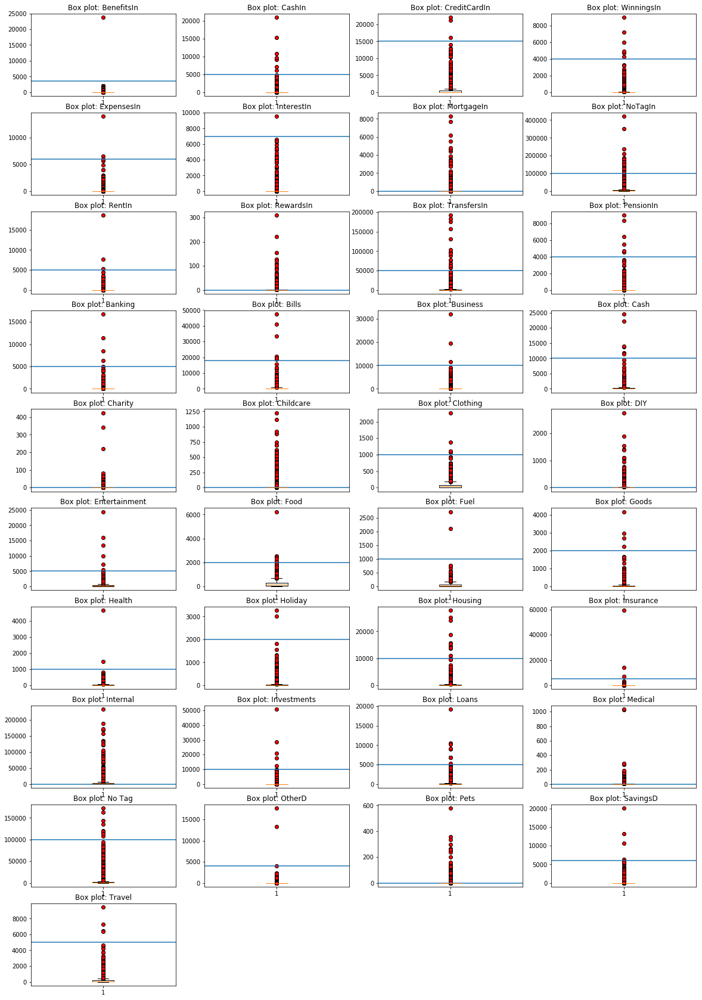

(9642, 37)


Double check shape
----------------------


In [35]:
red_circle=dict(markerfacecolor='red', marker='o')


thresholds = [3500,5000,15000,4000,6000,7000,0,100000,5000,0,50000,4000,5000,18000,10000,10000,0,0,1000,0,5000,2000,1000,2000,1000,2000,10000,5000,0,10000,5000,0,100000,4000,0,6000,5000]

def PlotOutliers(inputFeatures):
    for idx, col in enumerate(inputFeatures):    
        ax = plt.subplot(10,4,idx+1)
        ax.boxplot(inputFeatures[col], showfliers=True, flierprops=red_circle)
        ax.axhline(thresholds[idx])
        plt.title("Box plot: %s" % col)    


plt.figure(idx,figsize=(20,30))
PlotOutliers(inputFeatures)
plt.show()
print("\nDouble check shape")
print("----------------------")
display(inputFeatures.shape)

As we are reviewing averages we need to go back to the unflattened data to see if it is a single Tranaction that is causing the outlier in which case we can remove as is likely to be a one-off event. If it is more systematic than that then I will need to decide whether to keep the user or not.

In [36]:
display(IFrame("files/OutlierThresholds.html", width=700, height=400))

<font color='blue'>Having reviewed the outliers it is apparent that there are a combination of mis-coding by the data provider, outlier User types and some instances where a single large deposit or purchase has caused the outlier. The review and refinement of effectively removing outlier instances could in itself comprise a mini-project so I will take a simple but effective approach to dealing with the outliers. Instances where the UserSID instance is greater than 2 then I will remove this user from the dataset. It can be seen from the outlier data that in the main these are definitely non-representative and would skew the results. A handful of valid users may be removed certainly where the data provider has mis-coded the Tag Name but this should have no negative effects overall</font>

In [37]:
# Push Deposits To File For Review
depositsNames = {"BenefitsIn":"Benefits",
"CashIn":"Cash", \
"CreditCardIn":"Credit Card", \
"WinningsIn":"Enjoyment", \
"ExpensesIn":"Expenses", \
"InterestIn":"Interest income", \
"MortgageIn":"Mortgage release", \
"NoTagIn":"No Tag", \
"RentIn":"Rental income (whole property)", \
"RewardsIn":"Rewards/cashback", \
"TransfersIn":"Transfers", \
"PensionIn":"Work pension"}

dfOutliersDeposits = pd.DataFrame()
for idx, key in enumerate(depositsNames):    
    if thresholds[idx]>0:
        oName = depositsNames[key]
        for jdx, uid in enumerate(dfUsersCombined[dfUsersCombined[key]>thresholds[idx]]["UserSID"]):
            results = dfDeposits[(dfDeposits["TagName"] == oName) & (dfDeposits["Amount"] > 2 * thresholds[idx])]
            results["Outlier"] = key
            dfOutliersDeposits = pd.concat([dfOutliersDeposits, results])

dfOutliersDeposits.drop_duplicates(subset="TransactionSID", keep="first", inplace=True)
dfOutliersDeposits.to_csv(REPORTS_DIR + "OutliersDeposits.csv")  

C:\Program Files (x86)\Microsoft Visual Studio\Shared\Anaconda3_64\lib\site-packages\ipykernel_launcher.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [38]:
display(IFrame("files/DepositsOutliers.html", width=900, height=500))

In [39]:
dfOutliersSpend = pd.DataFrame()
spendNames = ["Banking","Bills","Business","Cash","Charity","Childcare","Clothing","DIY","Entertainment","Food","Fuel","Goods","Health","Holiday","Housing","Insurance","Internal","Investments","Loans","Medical","No Tag","OtherD","Pets","SavingsD","Travel"]
for oName in spendNames:
    idx = inputFeatures.columns.get_loc(oName)
    if thresholds[idx]>0:
        for jdx, uid in enumerate(dfUsersCombined[np.abs(dfUsersCombined[oName])>thresholds[idx]]["UserSID"]):
            results = dfSpends[(dfSpends["GroupedTag"] == oName) & (np.abs(dfSpends["Amount"]) > 2 * thresholds[idx])]
            dfOutliersSpend = pd.concat([dfOutliersSpend, results])
          
            
dfOutliersSpend.drop_duplicates(subset="TransactionSID", keep="first", inplace=True)
dfOutliersSpend.to_csv(REPORTS_DIR + "OutliersSpend.csv")  

In [40]:
display(IFrame("files/SpendOutliers.html", width=900, height=500))

The code below removes the Users who have been classified as Outlier users.

In [41]:
print("Shape before")
print(dfUsersCombined.shape)

# drop outlier deposit users
for value, count in dfOutliersDeposits["UserSID"].value_counts().items():
    if count>2:
        dfUsersCombined.drop(dfUsersCombined[dfUsersCombined["UserSID"] == value].index,inplace=True)

# drop outlier spend users
for value, count in dfOutliersSpend["UserSID"].value_counts().items():
    if count>2:
        dfUsersCombined.drop(dfUsersCombined[dfUsersCombined["UserSID"] == value].index,inplace=True)
        
print("Shape after")
print(dfUsersCombined.shape)

Shape before
(9642, 53)
Shape after
(9579, 53)


Must remember to re-create the input features now that the outliers have been removed.

Re-run the boxplots to double check that the removal has been successful.


Top 5 rows of features
----------------------


,BenefitsIn,CashIn,CreditCardIn,WinningsIn,ExpensesIn,InterestIn,MortgageIn,NoTagIn,RentIn,RewardsIn,...,Insurance,Internal,Investments,Loans,Medical,No Tag,OtherD,Pets,SavingsD,Travel
0,0.0,1000.0,0.00,0.000000,0.0,0.158000,0.0,9170.554000,0.0,0.0,...,143.828000,1666.942000,0.000000,0.000000,30.681000,5205.173000,21.041000,7.434,0.000000,36.656000
1,101.2,0.0,0.00,34.091111,0.0,0.156667,0.0,5312.424444,0.0,0.0,...,233.491111,565.380000,2.228889,469.942222,0.000000,1035.866667,9.637778,0.000,0.000000,52.066667
3,0.0,0.0,2458.85,5.769231,0.0,19.230769,0.0,12497.216154,0.0,0.0,...,2.061538,3321.028462,3.230769,0.000000,11.461538,1900.203077,12.573077,0.000,57.692308,275.254615
5,0.0,0.0,0.00,3.461538,0.0,0.000000,0.0,5641.923077,0.0,0.0,...,19.479231,5384.615385,0.000000,0.000000,0.000000,59.076923,0.000000,0.000,0.000000,0.000000
6,0.0,0.0,0.00,11.660000,0.0,0.000000,0.0,2772.045833,0.0,0.0,...,12.223846,1008.141538,0.000000,288.507692,0.000000,596.656923,16.792308,0.000,0.000000,14.306923



Double check shape
----------------------
(9579, 37)


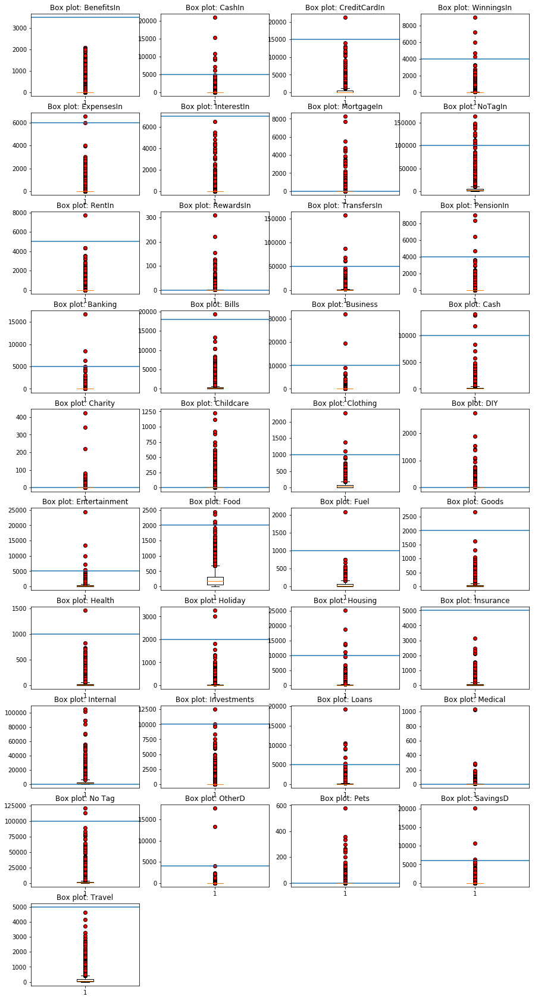

In [42]:
inputFeatures = SetUpInputFeatures(dfUsersCombined, TransactionRange)
print("\nTop 5 rows of features")
print("----------------------")
display(inputFeatures.head())

print("\nDouble check shape")
print("----------------------")
print(inputFeatures.shape)

plt.figure(idx,figsize=(15,30))
PlotOutliers(inputFeatures)
plt.show()


<p><font color='blue'>Reviewing the box plots shows that a lot of the outliers have been removed. I am comfortable with the outliers that remain.</font></p>


## Transformations

<p>As highlighted by the statistics, the data is zero-inflated and very positively skewed. Applying a log transformation with a small zero shift should do two things, blow out the distribution and scale the ranges, which is something else that was required on review of the statistics</p>

<p>Lets review the histograms for spend based on untransformed and log transformed</p>

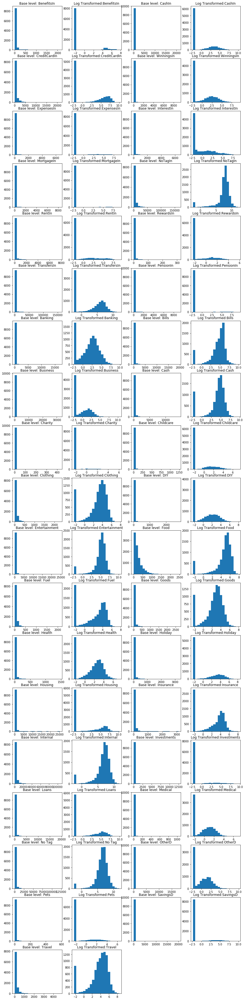

<Figure size 432x288 with 0 Axes>

In [43]:

f = plt.figure(idx,figsize=(15,70))
for idx, col in enumerate(inputFeatures):    
    plt.subplot(20,4,(idx*2)+1)
    plt.hist(inputFeatures[col],bins=20)
    plt.title("Base level: %s" % col)    
    plt.subplot(20,4,(idx*2)+2)
    plt.hist(np.add(inputFeatures[col],0.1).apply(np.log),bins=20)    
    plt.title("Log Transformed:%s" % col)

plt.show()
plt.tight_layout()

Transforming the data with log function seems to normalize data to some degree, though zero-inflation problem persists

### Correlations

Review the statistics to ensure that the scale is within reasonable bounds i.e. the distance between any single feature isn't too out of scale to present a problem with the other features.

Then produce a pairwise plot to ensure that the log transformation has produced the desired affect.

In [44]:

def LogTransform(inputFeatures):
    inputFeaturesLog = pd.DataFrame()
    for idx,col in enumerate(inputFeatures):
        inputFeaturesLog[col] = np.add(inputFeatures[col],0.1).apply(np.log)
        
    return inputFeaturesLog

# Log transform in order to get better distribution
inputFeaturesLog = LogTransform(inputFeatures)
inputFeaturesLog.head()

,BenefitsIn,CashIn,CreditCardIn,WinningsIn,ExpensesIn,InterestIn,MortgageIn,NoTagIn,RentIn,RewardsIn,...,Insurance,Internal,Investments,Loans,Medical,No Tag,OtherD,Pets,SavingsD,Travel
0,-2.302585,6.907855,-2.302585,-2.302585,-2.302585,-1.354796,-2.302585,9.123764,-2.302585,-2.302585,...,4.969313,7.418806,-2.302585,-2.302585,3.426898,8.557427,3.051214,2.019426,-2.302585,3.604301
1,4.618086,-2.302585,-2.302585,3.531966,-2.302585,-1.359977,-2.302585,8.577822,-2.302585,-2.302585,...,5.453572,6.337675,0.845391,6.152823,-2.302585,6.943090,2.276013,-2.302585,-2.302585,3.954444
3,-2.302585,-2.302585,7.807490,1.769724,-2.302585,2.961698,-2.302585,9.433269,-2.302585,-2.302585,...,0.770820,8.108060,1.203203,-2.302585,2.447684,7.549769,2.539480,-2.302585,4.056856,5.618060
5,-2.302585,-2.302585,-2.302585,1.270193,-2.302585,-2.302585,-2.302585,8.637998,-2.302585,-2.302585,...,2.974469,8.591320,-2.302585,-2.302585,-2.302585,4.080532,-2.302585,-2.302585,-2.302585,-2.302585
6,-2.302585,-2.302585,-2.302585,2.464704,-2.302585,-2.302585,-2.302585,7.927377,-2.302585,-2.302585,...,2.511536,6.915963,-2.302585,5.665068,-2.302585,6.391510,2.826858,-2.302585,-2.302585,2.667709


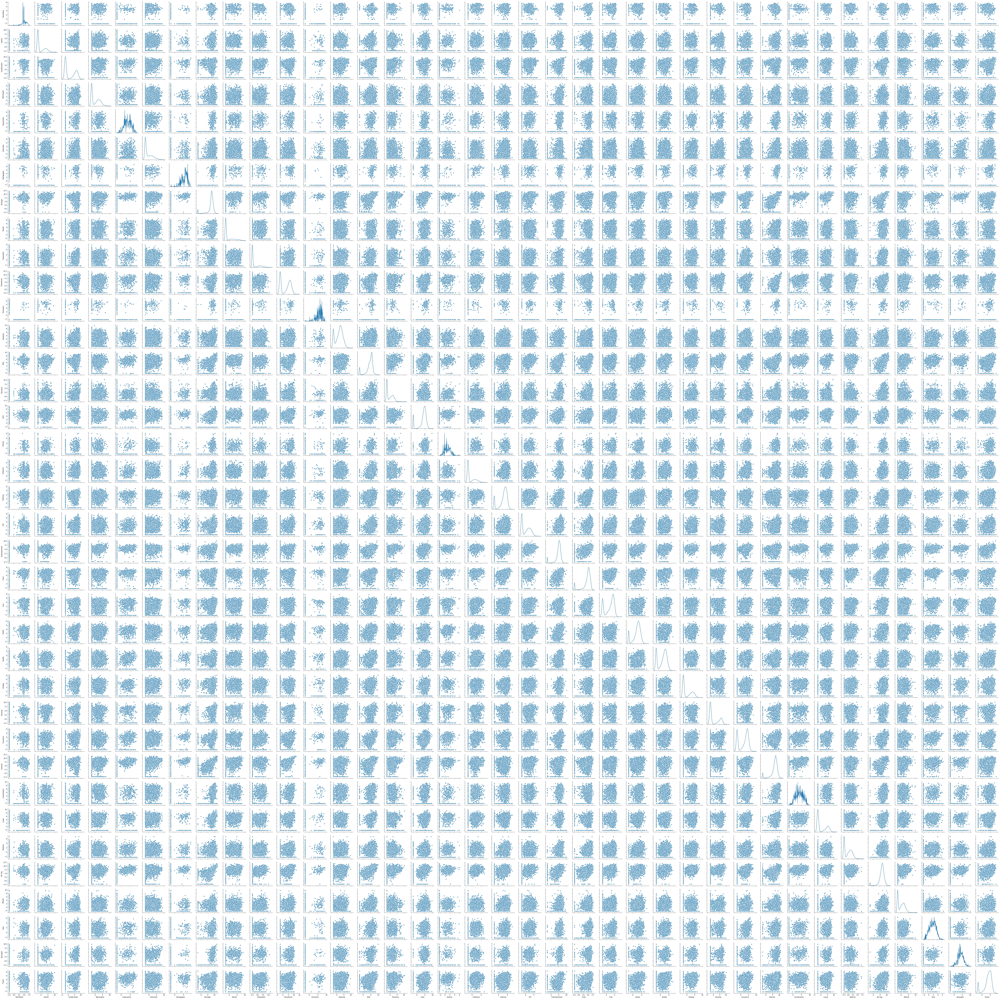

In [45]:
from seaborn import pairplot
fig = pairplot(inputFeaturesLog,diag_kind="kde")
fig.savefig(REPORTS_DIR + "logPairwisePlot.png")

<font color='blue'>A review of the transformed pairplots seems to indicate the log transformation has the desired affect. With regards to scaling, the smallest range was 8.040763 whereas the largest range was 14.311463. The min and max are in the same scale and as such no addition scaling is required. I will take this data forward.</font>

# Dimension Reduction

Now that the features have been transformed, PCA can potentially be used. The zero-inflated histograms still leave some question marks as to how successful PCA will be.

## PCA

We are starting with 37 features so if we go high on the number of components then we can review the variance of each of the PC's so see how many get us past 70%. A brief look at the pairwise plots would indicate that we will not be able to reduce down to a 2 PC's so visualizing results will need to be restricted to the first 2 PC's to gain an intuition as to whether it has been successful or not

In [46]:
from sklearn.decomposition import PCA

In [47]:
def RunPCA(inputFeatures, numberPCA):
    pca = PCA(n_components=numberPCAs)

    # fit the transformed features
    pca.fit(inputFeatures)

    projectedAxes = pca.transform(inputFeatures)

    # pairwise plot the pca's
    # now on to drawing
    #pairplot(pd.DataFrame(projectedAxes))
    
    return pca, projectedAxes

# build a model that returns 10 principals components as we have 25 input features
numberPCAs = 15
pca,projectedAxes = RunPCA(inputFeaturesLog, numberPCAs)


The resulting PC pairwise plots show well scattered data as we would expect.

In order to determine minimum number of PC's to take forward to the clustering stage, print out the variance accounted for by each PC

In [48]:
def ComponentVariance(pca):
    total = 0
    for idx in range(numberPCAs):
        total=total+pca.explained_variance_ratio_[idx]
        print("Variance explained by PC%f: %f (Total: %f)" % (idx, pca.explained_variance_ratio_[idx], total ))
        
ComponentVariance(pca)        

Variance explained by PC0.000000: 0.247877 (Total: 0.247877)
Variance explained by PC1.000000: 0.088512 (Total: 0.336389)
Variance explained by PC2.000000: 0.063694 (Total: 0.400083)
Variance explained by PC3.000000: 0.055072 (Total: 0.455155)
Variance explained by PC4.000000: 0.049600 (Total: 0.504755)
Variance explained by PC5.000000: 0.039680 (Total: 0.544435)
Variance explained by PC6.000000: 0.035626 (Total: 0.580060)
Variance explained by PC7.000000: 0.030602 (Total: 0.610662)
Variance explained by PC8.000000: 0.029326 (Total: 0.639988)
Variance explained by PC9.000000: 0.028697 (Total: 0.668685)
Variance explained by PC10.000000: 0.027276 (Total: 0.695961)
Variance explained by PC11.000000: 0.026497 (Total: 0.722458)
Variance explained by PC12.000000: 0.023061 (Total: 0.745519)
Variance explained by PC13.000000: 0.021317 (Total: 0.766836)
Variance explained by PC14.000000: 0.020347 (Total: 0.787183)


Reviewing PC variance, 11 PCA's takes over minimum threshold of 70%

In [49]:
# Set input components to be first 11 PC's
inputComponents = projectedAxes[:,0:11]
inputComponents.shape

(9579, 11)

Of equal importance and to provide some intuition behind the drivers for the PC's check the loadings i.e. see which of the original features was the main driver.

In [50]:
def CheckPCALoadings(pca, inputFeatures):
    
    # Lets check which original features contribute to each of the PC's
    print("PC0")
    comp1Loadings = np.asarray(pca.components_[0])[np.argsort( np.abs(pca.components_[0]))[::-1]][0:len(inputFeatures.columns)]
    comp1Names = np.asarray(inputFeatures.columns)[np.argsort( np.abs(pca.components_[0]))[::-1]][0:len(inputFeatures.columns)]
    for i in range(len(inputFeatures.columns)):
        print ( "Column \"" , comp1Names[i] , "\" has a loading of: ", comp1Loadings[i])
        if i == 5:
            break    



    # Lets check which original features contribute to each of the PC's
    print("PC1")
    comp2Loadings = np.asarray(pca.components_[1])[np.argsort( np.abs(pca.components_[1]))[::-1]][0:len(inputFeatures.columns)]
    comp2Names = np.asarray(inputFeatures.columns)[np.argsort( np.abs(pca.components_[1]))[::-1]][0:len(inputFeatures.columns)]
    for i in range(len(inputFeatures.columns)):
        print ( "Column \"" , comp2Names[i] , "\" has a loading of: ", comp2Loadings[i])
        if i == 5:
            break

    # Lets check which original features contribute to each of the PC's
    print("PC2")
    comp3Loadings = np.asarray(pca.components_[2])[np.argsort( np.abs(pca.components_[2]))[::-1]][0:len(inputFeatures.columns)]
    comp3Names = np.asarray(inputFeatures.columns)[np.argsort( np.abs(pca.components_[2]))[::-1]][0:len(inputFeatures.columns)]
    for j in range(len(inputFeatures.columns)):
        print ( "Column \"" , comp3Names[j] , "\" has a loading of: ", comp3Loadings[j])
        if j == 5:
            break

    # Just pull out top 2 from the rest of the PCs
    for i in range(3,numberPCAs):
        print("PC%d" % (i))
        compLoadings = np.asarray(pca.components_[i])[np.argsort( np.abs(pca.components_[i]))[::-1]][0:len(inputFeatures.columns)]
        compNames = np.asarray(inputFeatures.columns)[np.argsort( np.abs(pca.components_[i]))[::-1]][0:len(inputFeatures.columns)]
        for j in range(len(inputFeatures.columns)):
            print ( "Column \"" , compNames[j] , "\" has a loading of: ", compLoadings[j])
            if j == 2:
                break

CheckPCALoadings(pca, inputFeaturesLog)                

PC0
Column " TransfersIn " has a loading of:  -0.2566351289717721
Column " Insurance " has a loading of:  -0.2546720064141607
Column " Bills " has a loading of:  -0.2356544877106817
Column " Cash " has a loading of:  -0.22585244328483953
Column " Housing " has a loading of:  -0.22229250321819735
Column " Internal " has a loading of:  -0.22019852626901137
PC1
Column " CreditCardIn " has a loading of:  0.7761487206681069
Column " TransfersIn " has a loading of:  -0.47299729625683584
Column " Cash " has a loading of:  -0.17527496309372256
Column " Holiday " has a loading of:  0.16048424668758374
Column " NoTagIn " has a loading of:  -0.15345546965212473
Column " Internal " has a loading of:  -0.14324431054852654
PC2
Column " TransfersIn " has a loading of:  0.6765742763342132
Column " CreditCardIn " has a loading of:  0.3345654710370337
Column " Housing " has a loading of:  0.273140210938223
Column " Fuel " has a loading of:  -0.2189432054685192
Column " Loans " has a loading of:  -0.1926

Reviewing the loadings for PC0, seems odd that insurance has such a big impact!

Lets double check what original Tags are attributed to Insurance make sure that there have been no mistakes!

In [51]:
unique, counts = np.unique(dfSpends[dfSpends["GroupedTag"]=="Insurance"]["TagName"], return_counts=True)
print(np.asarray((unique, counts)).T)   

[['Contents or Other Insurance' 5025]
 ['Dental insurance' 3465]
 ['Health insurance' 5914]
 ['Home appliance insurance' 5090]
 ['Home insurance' 6269]
 ['Income insurance' 112]
 ['Insurance' 65164]
 ['Insurance - other' 2510]
 ['Life insurance' 17271]
 ['Mobile phone insurance' 1316]
 ['Motorbike Insurance' 23]
 ['Payment Protection Insurance' 371]
 ['Pet Insurance' 13096]
 ['Vehicle insurance' 17135]]


This seems OK.

Now reviewing the rest of the loadings, I would expect Housing to have a big impact, but just double check groupings

In [52]:
unique, counts = np.unique(dfSpends[dfSpends["GroupedTag"]=="Housing"]["TagName"], return_counts=True)
print(np.asarray((unique, counts)).T)

[['Mortgage or Rent' 5746]
 ['Mortgage payment' 14449]
 ['Rent' 16224]]


<font color='blue'>Due to the curse of dimensionality, it is important that we reduce the number of features and as such, the decision has been made to use the PC's to do the clustering</font>

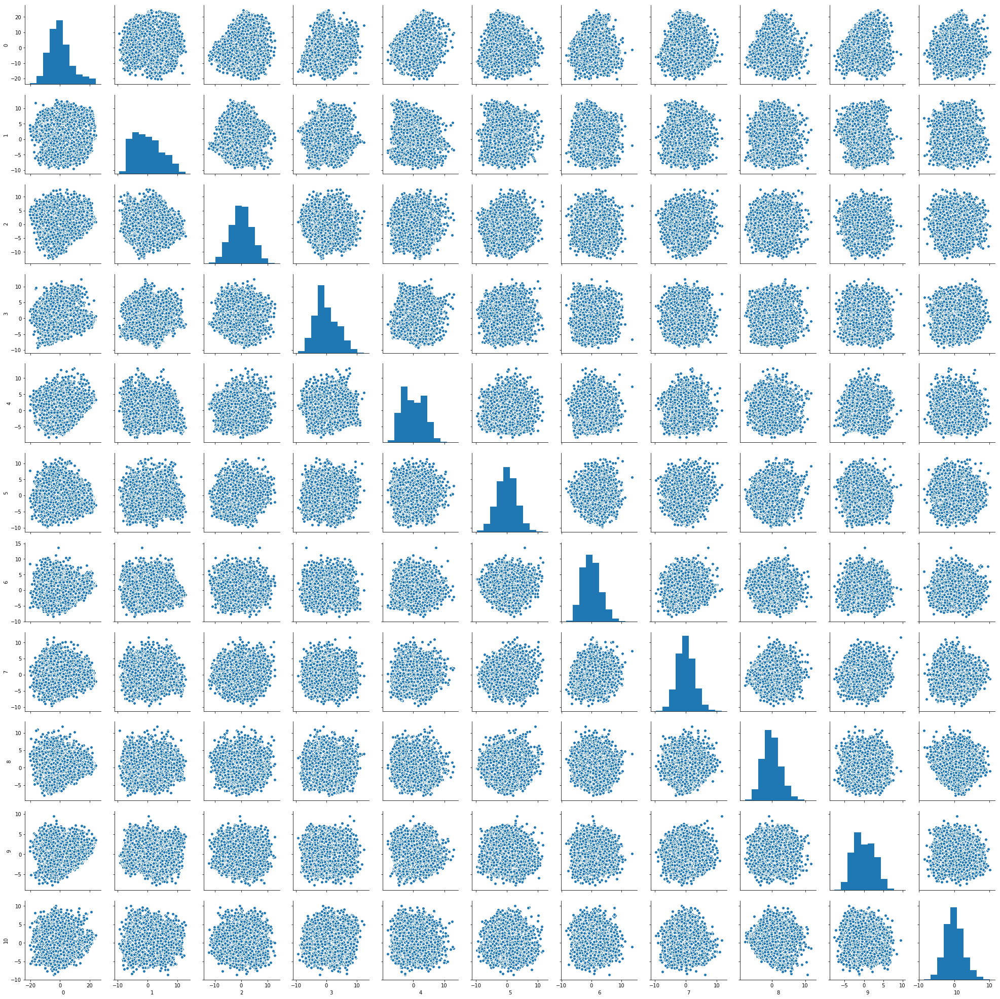

In [53]:
fig = pairplot(pd.DataFrame(inputComponents))
fig.savefig(REPORTS_DIR + "componentPairwisePlot.png")

The pairwise plots of the PC's do not offer up any clear clustering. I speculate that this is due to the zero-inflated data. Although there are no obvious clusters in 2-dimensions there may be in 3+ dimensions. Reducing the opacity may offer up some insight as to whether there are some clusters, reviewing pc0 v pc1 with alpha=0.1 below shows that there may been some hidden inherent structures and as such I will continue with the clustering. Using scaling to elongate the structures.

Text(0.5,1,'Scatter plot of first 2 PC, with alpha=.1')

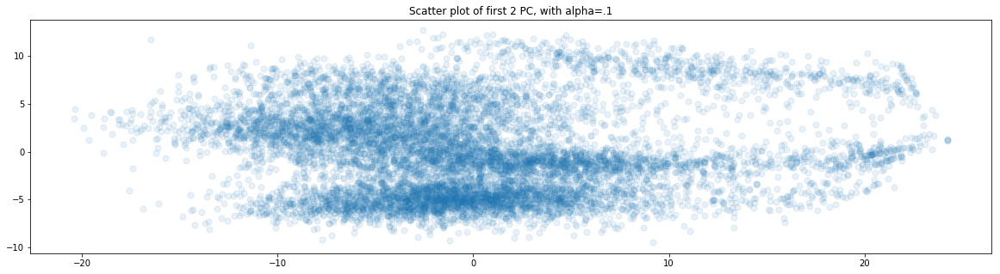

In [54]:
plt.figure(figsize=(20,5))
plt.scatter(inputComponents[:,0], inputComponents[:,1], alpha=.1, s=50)
plt.show
plt.title("Scatter plot of first 2 PC, with alpha=.1")

# Clustering


Now that we have the principal components we can turn to the clustering algorithms.

## K-Means

Now using k-means clustering to see if there are inherent structures to the data. 

In [55]:
# imports required for clustering
import matplotlib as mpl


from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn import metrics
from matplotlib.patches import Ellipse, Circle
from sklearn import mixture
from scipy import linalg

The first to do is determine how many clusters is appropriate to target. Using an elbow curve to get roughly the number of clusters is a good place to start.

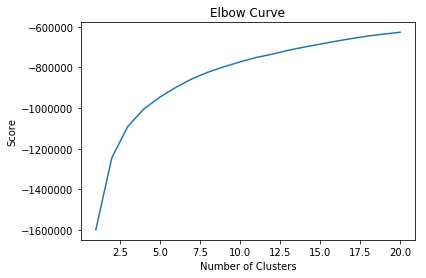

In [56]:
def PlotElbowCurve(inputFeatures, maxClusters):
    rangeClusters = range(1,maxClusters+1)
    kmeans = [KMeans(n_clusters=i) for i in rangeClusters]
    score = [kmeans[i].fit(inputFeatures).score(inputFeatures) for i in range(len(kmeans))]

    plt.plot(rangeClusters,score)
    plt.xlabel('Number of Clusters')
    plt.ylabel('Score')
    plt.title('Elbow Curve')
    plt.show()

maxClusters = 20;
PlotElbowCurve(inputComponents, maxClusters)


Looks like 5 is broadly the correct number of clusters. The smoothness of the elbow curve is a bit concerning so additional validation required as this is pretty inconclusive so run silhouette scores to evaluate whether clustering is successful. 

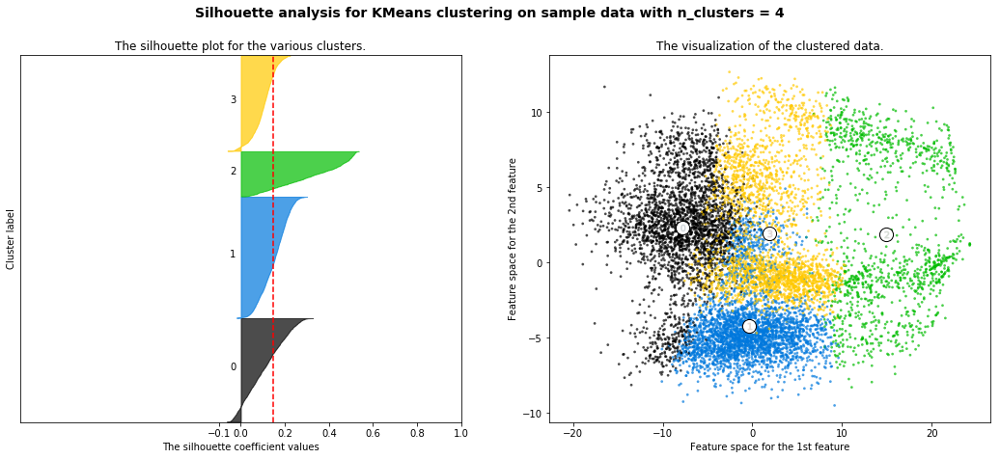

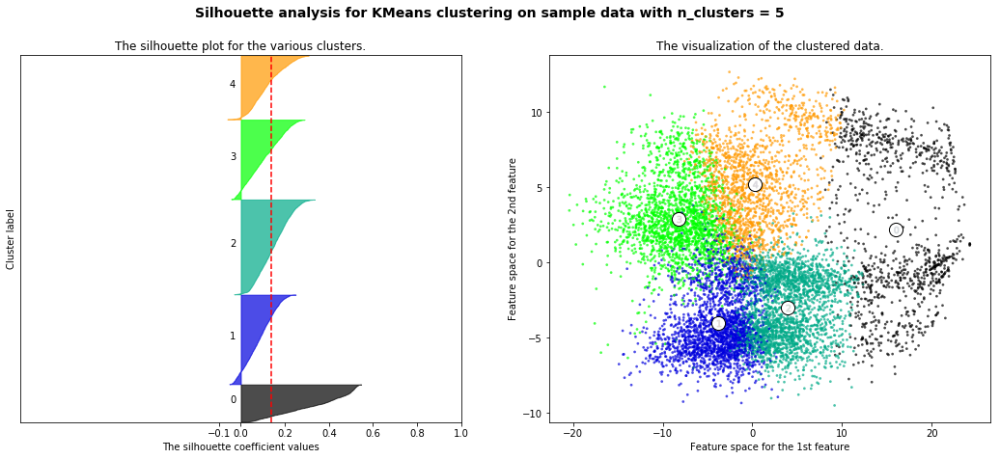

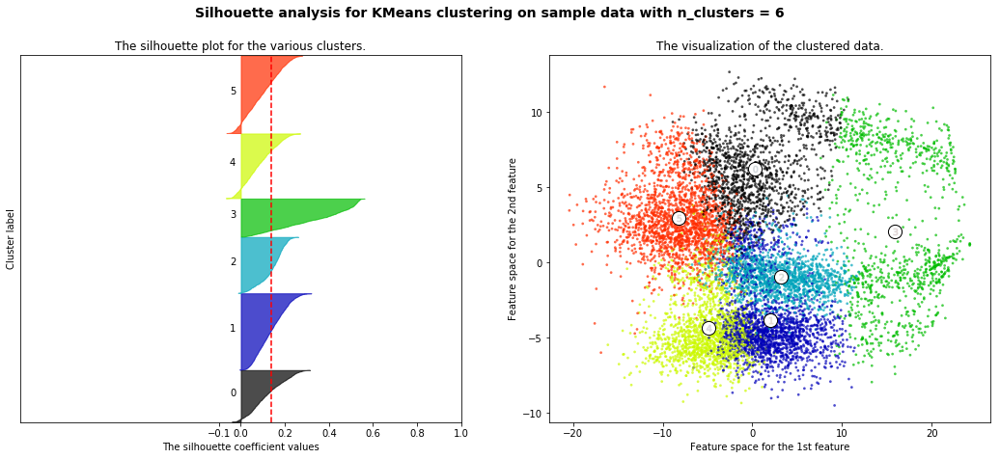

In [57]:
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm

# note this is pulled directly from scikit-learn help
def PlotSilhouette(X, range_n_clusters):

    for n_clusters in range_n_clusters:
        # Create a subplot with 1 row and 2 columns
        fig, (ax1, ax2) = plt.subplots(1, 2)
        fig.set_size_inches(18, 7)

        # The 1st subplot is the silhouette plot
        # The silhouette coefficient can range from -1, 1
        ax1.set_xlim([-1, 1])
        # The (n_clusters+1)*10 is for inserting blank space between silhouette
        # plots of individual clusters, to demarcate them clearly.
        ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

        # Initialize the clusterer with n_clusters value and a random generator
        # seed of 10 for reproducibility.
        clusterer = KMeans(n_clusters=n_clusters, random_state=10)
        cluster_labels = clusterer.fit_predict(X)

        # The silhouette_score gives the average value for all the samples.
        # This gives a perspective into the density and separation of the formed
        # clusters
        silhouette_avg = silhouette_score(X, cluster_labels)
        #print("For n_clusters =", n_clusters,
        #      "The average silhouette_score is :", silhouette_avg)

        # Compute the silhouette scores for each sample
        sample_silhouette_values = silhouette_samples(X, cluster_labels)

        y_lower = 10
        for i in range(n_clusters):
            # Aggregate the silhouette scores for samples belonging to
            # cluster i, and sort them
            ith_cluster_silhouette_values = \
                sample_silhouette_values[cluster_labels == i]

            ith_cluster_silhouette_values.sort()

            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i

            color = cm.nipy_spectral(float(i) / n_clusters)
            ax1.fill_betweenx(np.arange(y_lower, y_upper),
                              0, ith_cluster_silhouette_values,
                              facecolor=color, edgecolor=color, alpha=0.7)

            # Label the silhouette plots with their cluster numbers at the middle
            ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

            # Compute the new y_lower for next plot
            y_lower = y_upper + 10  # 10 for the 0 samples

        ax1.set_title("The silhouette plot for the various clusters.")
        ax1.set_xlabel("The silhouette coefficient values")
        ax1.set_ylabel("Cluster label")

        # The vertical line for average silhouette score of all the values
        ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

        ax1.set_yticks([])  # Clear the yaxis labels / ticks
        ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

        # 2nd Plot showing the actual clusters formed
        colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
        ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                    c=colors, edgecolor='k')

        # Labeling the clusters
        centers = clusterer.cluster_centers_
        # Draw white circles at cluster centers
        ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                    c="white", alpha=1, s=200, edgecolor='k')

        for i, c in enumerate(centers):
            ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=0.1,
                        s=50, edgecolor='k')

        ax2.set_title("The visualization of the clustered data.")
        ax2.set_xlabel("Feature space for the 1st feature")
        ax2.set_ylabel("Feature space for the 2nd feature")

        plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                      "with n_clusters = %d" % n_clusters),
                     fontsize=14, fontweight='bold')

    plt.show()
    
# Plot silohouettes
range_n_clusters = [4, 5, 6]
PlotSilhouette(inputComponents, range_n_clusters)

<font color='blue'>The silhouette plots with plots of first 2 PC's would seem to indicate that 5 clusters (agreeing with elbow curve) would be the most appropriate number of clusters as derived from k-means. That said, the silhouette coefficients are low and the plots of the first 2 PC's for clusters=5 shows what to be a clear top cluster split into 2, which leads me to think that maybe there are better clustering algorithms than k-means for determining the clusters for this data.</font>

In [58]:
kmeans5 = KMeans(n_clusters=5, random_state=10).fit_predict(inputComponents)
np.unique(kmeans5, return_counts=True)

(array([0, 1, 2, 3, 4]), array([ 981, 2348, 2491, 2087, 1672], dtype=int64))

After reviewing the course notes and also the related online help for scikit, there are 2 potential clustering algorithms that would be better suited to these cluster shapes. DBScan and GMM.

## DBSCAN

DBSCAN offers a density based clustering method and reviewing the scatters of the first 2 PC's it has potential to capture the natural shapes of the apparent clusters

There are a couple of hyper-parameters that we need to review in order to optimize the solution. The distance between points and also the number of points.

Try a combination of distances and points to see which combination best captures the structures.

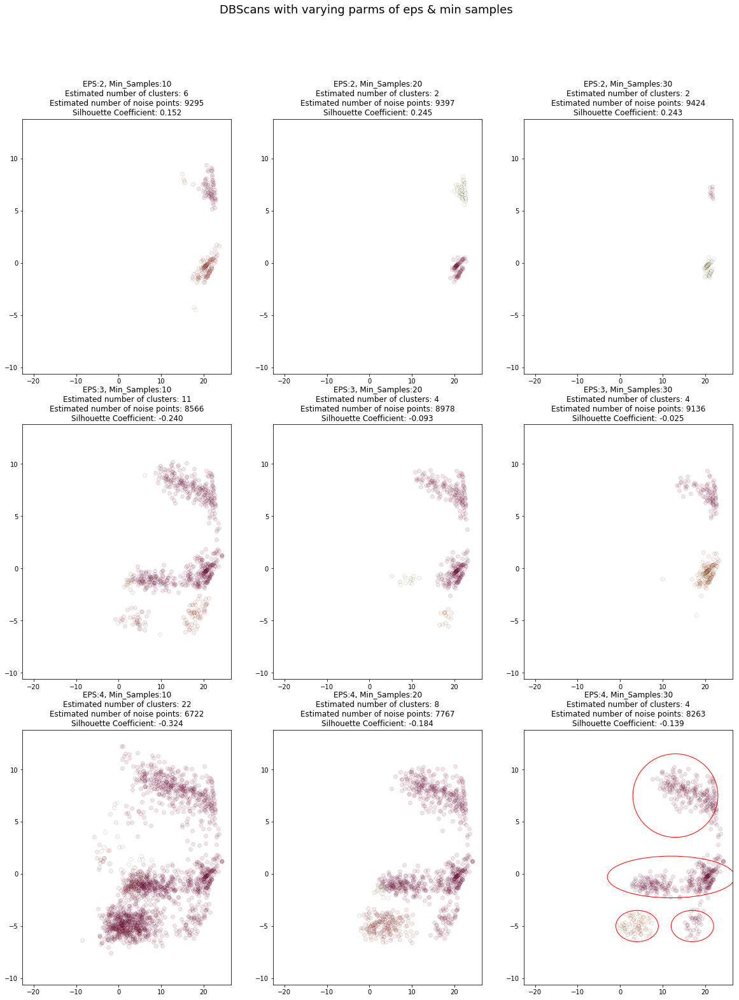

In [59]:
# Compute DBSCAN
def PrintAndPlotResults(db,eps,samples, inputFeatures):
    core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
    core_samples_mask[db.core_sample_indices_] = True
    labels = db.labels_

    # Number of clusters in labels, ignoring noise if present.
    n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
    n_noise_ = list(labels).count(-1)

    if n_clusters_ < 1:
        return
    
    plt.title('EPS:%d, Min_Samples:%d\nEstimated number of clusters: %d\nEstimated number of noise points: %d\nSilhouette Coefficient: %0.3f' % \
              (eps, samples, n_clusters_,n_noise_,metrics.silhouette_score(inputFeatures, labels)))
    
    # Black removed and is used for noise instead.
    unique_labels = set(labels)
    colors = [plt.cm.Spectral(each)
              for each in np.linspace(0, 1, len(unique_labels))]

    for k, col in zip(unique_labels, colors):
        if k == -1:
            # Black used for noise.
            col = [0, 0, 0, 1]

        class_member_mask = (labels == k)

        xy = inputFeatures[class_member_mask & core_samples_mask]
        plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col),
                 markeredgecolor='k', markersize=6, alpha=0.1)

        xy = inputFeatures[class_member_mask & ~core_samples_mask]
        plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col),
                 markeredgecolor='k', markersize=0, alpha=0.1)

    # stick a circle round the outer cluster to aid reference NOTE: retro fitted
    if (eps == 4) & (samples==30):
        elip=Ellipse((17,-5),10,3,color='r', fill=False)
        plt.gcf().gca().add_artist(elip)  
        
        elip=Ellipse((4,-5),10,3,color='r', fill=False)
        plt.gcf().gca().add_artist(elip) 

        elip=Ellipse((12,-0.3),30,4,color='r', fill=False)
        plt.gcf().gca().add_artist(elip) 
        
        elip=Ellipse((13,7.5),20,8,color='r', fill=False)
        plt.gcf().gca().add_artist(elip)         
    
# run multiple eps and samples
plt.figure(figsize=(20,25))    
plt.suptitle("DBScans with varying parms of eps & min samples",fontsize=18)
idx=1

EPS = [2,3,4]
SAMPLES = [10,20,30]

for eps in EPS:
    for samples in SAMPLES:
        db = DBSCAN(eps=eps, min_samples=samples).fit(inputComponents)
        plt.subplot(len(SAMPLES),len(EPS),idx)
        PrintAndPlotResults(db,eps,samples, inputComponents)
        idx=idx+1
        

plt.savefig(REPORTS_DIR + "DBScans.png")

<font color='blue'>DBScan offers some good insights into the data. It shows that there is a high density cluster previously unidentified by the k-means clustering so will capture this detail and push back to the data to see if there are significant correlations of those cases.

DBSCAN does not seem to generalize very well though, I think this is because the densities vary greatly. The lower cluster is very dense so as we tweak the parameters to try to capture the top cluster he lower cluster becomes dominant incorporating the "apparent" lower cluster so it would appear that although DBSCAN may offer some insight into the data, it fails to generalize the clusters particularly well.</font>

In [60]:
# store so that they can be pushed back
db4_30 = DBSCAN(eps=4, min_samples=30).fit(inputComponents)
np.unique(db4_30.labels_, return_counts=True)

(array([-1,  0,  1,  2,  3], dtype=int64),
 array([8263,  941,  258,   68,   49], dtype=int64))

## GMM

GMM is the last clustering algorithm that appears to suit the situation. There are a couple of options Gaussion or Bayesian Gaussian Mixed Model with Dirichlet distribution. The advantage of the BGMM is in cases where the number of clusters is unknown. Through observation we can roughly tell how many clusters there are so GMM rather than BGMM would seem most appropriate. That said, it will be interesting to compare the results using GMM against those of BGMM with varying weights.

So for GMM I propose to use 4,5,6 components and for BGMM use weight_concentration_priors of 0.001, 1, 1000 and compare the results.

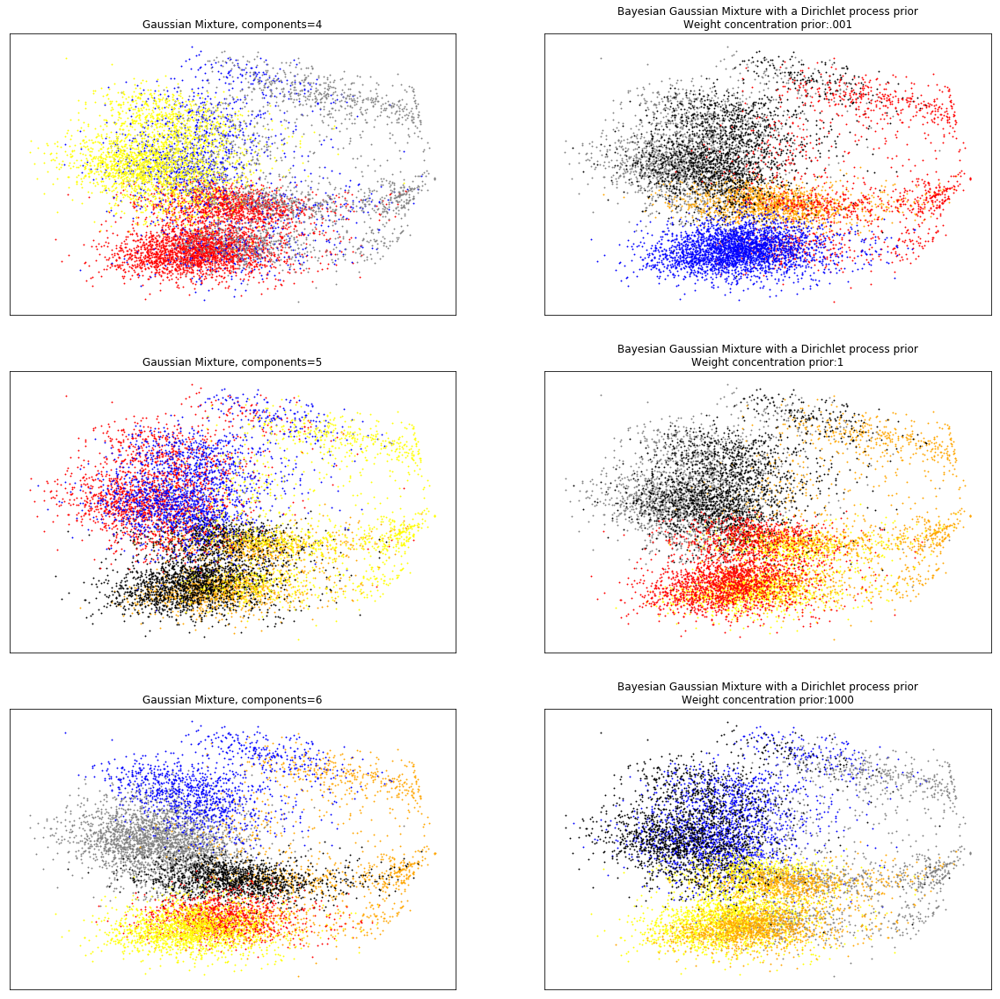

In [61]:


color_iter = itertools.cycle(['red', 'blue', 'yellow', 'grey', 'orange', 'black'])

def plot_results(X, Y_, means, covariances, index, title):
    
    plt.subplot(3, 2, 1 + index)
    for i, (mean, covar, color) in enumerate(zip(
            means, covariances, color_iter)):
        
        v, w = linalg.eigh(covar)
        v = 2. * np.sqrt(2.) * np.sqrt(v)
        u = w[0] / linalg.norm(w[0])
        
        # as the DP will not use every component it has access to
        # unless it needs it, we shouldn't plot the redundant
        # components.
        if not np.any(Y_ == i):
            continue
        plt.scatter(X[Y_ == i, 0], X[Y_ == i, 1], .8, color=color)

        # Plot an ellipse to show the Gaussian component
        #angle = np.arctan(u[1] / u[0])
        #angle = 180. * angle / np.pi  # convert to degrees
        #ell = mpl.patches.Ellipse(mean, v[0], v[1], 180. + angle, color=color)
        #ell.set_clip_box(splot.bbox)
        #ell.set_alpha(0.5)
        #splot.add_artist(ell)

    #plt.xlim(-9., 5.)
    #plt.ylim(-3., 6.)
    plt.xticks(())
    plt.yticks(())
    plt.title(title)


# Fit a Gaussian mixture with EM using five components
plt.figure(figsize=(20,20))
gmm3 = mixture.GaussianMixture(n_components=4, covariance_type='full')
gmm3.fit(inputComponents)
gmm3_labels = gmm3.predict(inputComponents)
plot_results(inputComponents, \
             gmm3_labels, \
             gmm3.means_, \
             gmm3.covariances_, \
             0, \
             'Gaussian Mixture, components=4')

# Fit a Gaussian mixture with EM using five components
gmm5 = mixture.GaussianMixture(n_components=5, covariance_type='full')
gmm5.fit(inputComponents)
gmm5_labels = gmm5.predict(inputComponents)
plot_results(inputComponents, \
             gmm5_labels, \
             gmm5.means_, \
             gmm5.covariances_, \
             2, \
             'Gaussian Mixture, components=5')

# Fit a Gaussian mixture with EM using five components
gmm7 = mixture.GaussianMixture(n_components=6, covariance_type='full')
gmm7.fit(inputComponents)
gmm7_labels = gmm7.predict(inputComponents)
plot_results(inputComponents, \
             gmm7_labels, \
             gmm7.means_, \
             gmm7.covariances_, \
             4, \
             'Gaussian Mixture, components=6')

# Fit a Dirichlet process Gaussian mixture using five components
dpgmm1 = mixture.BayesianGaussianMixture(n_components=5, \
                                         covariance_type='full', \
                                         weight_concentration_prior=0.001).fit(inputComponents)
plot_results(inputComponents, \
             dpgmm1.predict(inputComponents), \
             dpgmm1.means_, \
             dpgmm1.covariances_, \
             1, \
             'Bayesian Gaussian Mixture with a Dirichlet process prior\nWeight concentration prior:.001')

# Fit a Dirichlet process Gaussian mixture using five components
dpgmm2 = mixture.BayesianGaussianMixture(n_components=5, \
                                         covariance_type='full', \
                                         weight_concentration_prior=1).fit(inputComponents)
dpgmm2_labels = dpgmm2.predict(inputComponents)
plot_results(inputComponents, \
             dpgmm2_labels, \
             dpgmm2.means_, \
             dpgmm2.covariances_, \
             3, \
             'Bayesian Gaussian Mixture with a Dirichlet process prior\nWeight concentration prior:1')

# Fit a Dirichlet process Gaussian mixture using five components
dpgmm3 = mixture.BayesianGaussianMixture(n_components=5, \
                                         covariance_type='full', \
                                         weight_concentration_prior=1000).fit(inputComponents)
dpgmm3_labels = dpgmm3.predict(inputComponents)
plot_results(inputComponents, \
             dpgmm3_labels, \
             dpgmm3.means_, \
             dpgmm3.covariances_, \
             5, \
             'Bayesian Gaussian Mixture with a Dirichlet process prior\nWeight concentration prior:1000')

plt.show()

Both the GMM & BGMM, even after varying the weight parameters the GMM appears to identify the clusters and it appears to be that 5 clusters is the appropriate number of clusters.

In [62]:
print("\n")
print(np.unique(gmm5_labels, return_counts=True))
print(np.unique(dpgmm3_labels,return_counts=True))
print("\n")

# Lets see how much they overlap
print("\nCross Table of GMM results vs BGMM results to check for alignment\n")
print(pd.crosstab(gmm5_labels,dpgmm3_labels))




(array([0, 1, 2, 3, 4], dtype=int64), array([1822, 2446, 1954, 1934, 1423], dtype=int64))
(array([0, 1, 2, 3, 4], dtype=int64), array([1930, 2446, 1435, 1815, 1953], dtype=int64))



Cross Table of GMM results vs BGMM results to check for alignment

col_0     0     1     2     3     4
row_0                              
0         0     2     6  1814     0
1         0  2443     2     1     0
2         1     1     0     0  1952
3      1929     0     4     0     1
4         0     0  1423     0     0


<p><font color='blue'>In conclusion GMM with a target of 5 clusters appears to have been the best clustering algorithm of all used. </font></p>

<p>Lets push this back to the data to see if we can get any significant results based on these findings!</p>

<p><font color='red'>NOTE: due to changes when re-running a version of this file is preserved and used going forward</font></p>

In [63]:
pd.concat([pd.DataFrame(gmm5_labels), \
          pd.DataFrame(dpgmm3_labels), \
          pd.DataFrame(db4_30.labels_)], axis=1) \
        .to_csv(REPORTS_DIR + "dfClusters.csv") 

clusters = pd.read_csv(REPORTS_DIR + "dfClusters_in.csv",\
                                sep=",", \
                                skiprows=[0], \
                                names=["GMM","BGMM", "DBSCAN"])

In [64]:
# Must remember where the data came from so that cane push back with correct indexes
# Clustered on PC'
# PC's derived from log transforms
# Original features stored in "inputFeatures"
print(inputFeatures.shape)
print(inputFeaturesLog.shape)
print(inputComponents.shape)
print(clusters.shape)
print(dfUsersCombined.shape)
dfUsersClusters = dfUsersCombined.reset_index(drop=True)
dfUsersClusters = pd.concat([dfUsersClusters, clusters], axis=1)
print(dfUsersClusters.head())

# Push to Excel to see if anything meaningful jumps out
dfUsersClusters.to_csv(REPORTS_DIR + "UsersClusters.csv")
np.unique(dfUsersClusters["GMM"],return_counts=True)

(9579, 37)
(9579, 37)
(9579, 11)
(9579, 3)
(9579, 53)
   UserSID                RegionName GenderCode  YearOfBirth HomePostcode  \
0        8  Yorkshire and the Humber          M         1978       DN14 0   
1       15             West Midlands          F         1984       HR8  1   
2       25                    London          M         1980       HA3  0   
3      110                    London          M         1981       W6   0   
4      172                South East          M         1995       ME8  6   

   MosaicGroupCode  Credit Card  Current  OtherU  SavingsU   ...     SavingsD  \
0                7            1        6       0         0   ...     0.000000   
1                5            2        3       0         0   ...     0.000000   
2                7            3        1       0         0   ...   -57.692308   
3                1            0        3       0         0   ...     0.000000   
4                8            0       10       0         4   ...     0.000000 

(array([0, 1, 2, 3, 4], dtype=int64),
 array([1411, 2731,  980, 2109, 2348], dtype=int64))

# Results

The high dimensional nature of the data makes it difficult to visually pull out any meaningful detail.

Lets look to see if some visualizations could potentially help here. Heatmaps for the various clusters may be a good way to see if any patterns emerge

There are 1323 cases in the DBSCAN cluster.


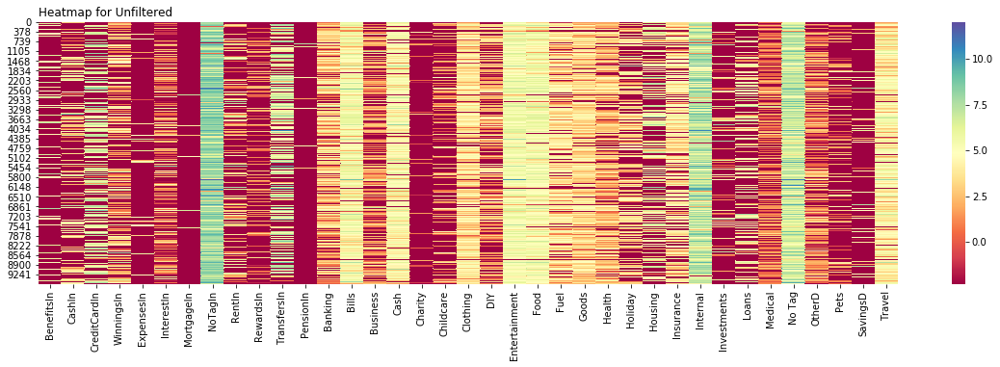

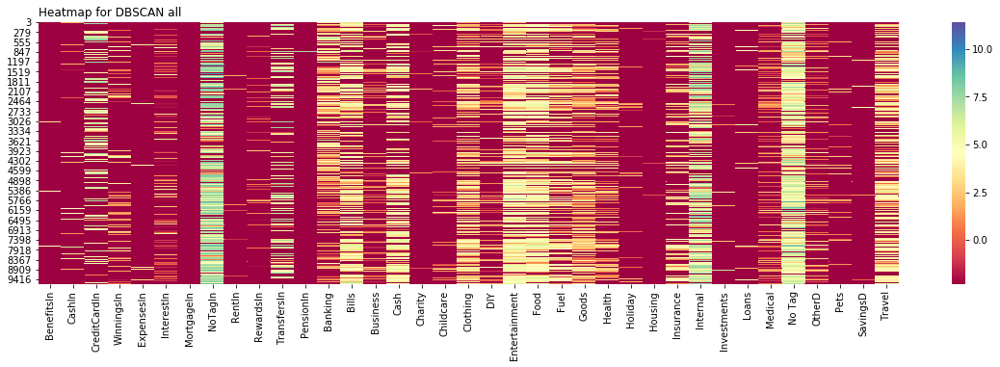

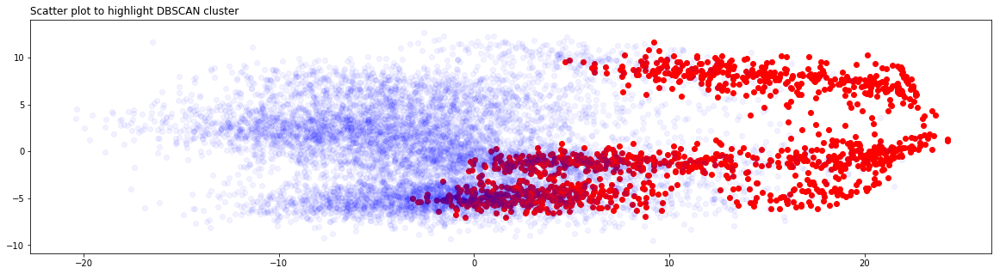

In [65]:
from seaborn import heatmap

# rather than normalising the data set, using the log transformed data would seem appropriate
inputFeaturesReset = inputFeatures.reset_index(drop=True)
inputFeaturesLogReset = inputFeaturesLog.reset_index(drop=True)

heatMapVars = inputFeaturesLogReset

plt.figure(1,figsize=(20,5))
heatmap(heatMapVars[clusters["DBSCAN"]==-1], cmap="Spectral")
plt.title("Heatmap for Unfiltered", loc='left')
plt.figure(2,figsize=(20,5))
heatmap(heatMapVars[clusters["DBSCAN"]>-1], cmap="Spectral")
plt.title("Heatmap for DBSCAN all", loc='left')

plt.figure(3, figsize=(20,5))
x = inputComponents[clusters["DBSCAN"]>-1]
y = inputComponents[clusters["DBSCAN"]==-1]
plt.scatter(x[:,0], x[:,1], c='r',alpha=1)
plt.scatter(y[:,0], y[:,1], c='b',alpha=0.05)
plt.title("Scatter plot to highlight DBSCAN cluster", loc='left')  
    
print("There are %d cases in the DBSCAN cluster." % (sum(clusters["DBSCAN"]>-1)))    


The cluster identified by DBSCAN looks as though it is has very little data, there are some extremely interesting patterns here. The one thing that jumps out is that there is very little spend across the main areas of Childcare to Housing. The most interesting of all is cluster 3, which has a very high Investment contribution. Additional investigation is required, these could be outliers maybe just accounts used for transferring money. Lets have a look at the Average Incomes and Average spends against the average.

In [66]:
userCombinedReset = dfUsersCombined.reset_index(drop=True)


grps = ["Noise","Cluster 0", "Cluster 1", "Cluster 2", "Cluster 3"]
for idx, val in enumerate([-1, 0, 1, 2, 3]):
    print("For: %s,Income: £%02d, Spend, £%2d" % (grps[idx], \
                                             np.sum(np.sum(userCombinedReset[clusters["DBSCAN"]==val].iloc[:,11:22])) / len(userCombinedReset[clusters["DBSCAN"]==val]), \
                                             np.abs(np.sum(np.sum(userCombinedReset[clusters["DBSCAN"]==val].iloc[:,23:47])) / len(userCombinedReset[clusters["DBSCAN"]==val])))
                                             )


For: Noise,Income: £7052, Spend, £6979
For: Cluster 0,Income: £1082, Spend, £1206
For: Cluster 1,Income: £2647, Spend, £2666
For: Cluster 2,Income: £2946, Spend, £3048
For: Cluster 3,Income: £2624, Spend, £2620


Set Age to support analysis ... remember just a guide Age is based on YearofBirth so maybe +/- 1 out

In [67]:
userCombinedReset["Age"] = 2018 - pd.to_numeric(userCombinedReset["YearOfBirth"])
userCombinedReset["MosaicGroup"] = userCombinedReset["MosaicGroupCode"].map({0:'None', 1:'A City Prosperity',2:'B Prestige Positions',3:'C Country Living',4:'D Rural Reality', \
5:'E Senior Security',6:'F Suburban Stability',7:'G Domestic Success',8:'H Aspiring Homemakers',9:'I Family Basics', \
10:'J Transient Renters', 11:'K Municipal Challenge', 12:'L Vintage Value', 13:'M Modest Traditions', 14:'N Urban Cohesion', \
15:'O Rental Hubs'})


<font color='blue'>The numbers for both Income & Spend for cluster 0 are extremely low, it appears that DBSCAN has been able to identify a subset of users, either low-income or potentially invalid user/ account combinations. This can be pushed back to data provider as a way of potentially identifying incomplete users/ accounts</font>

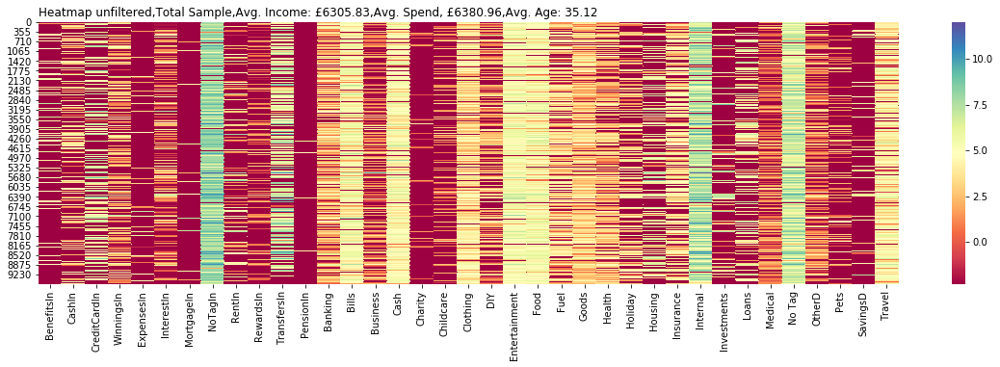

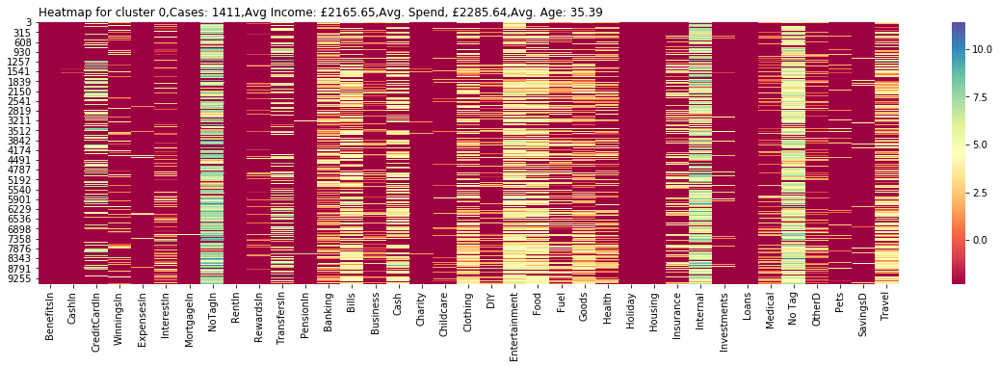

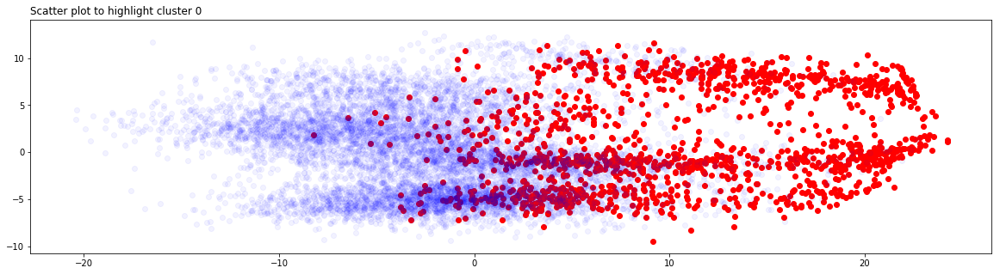

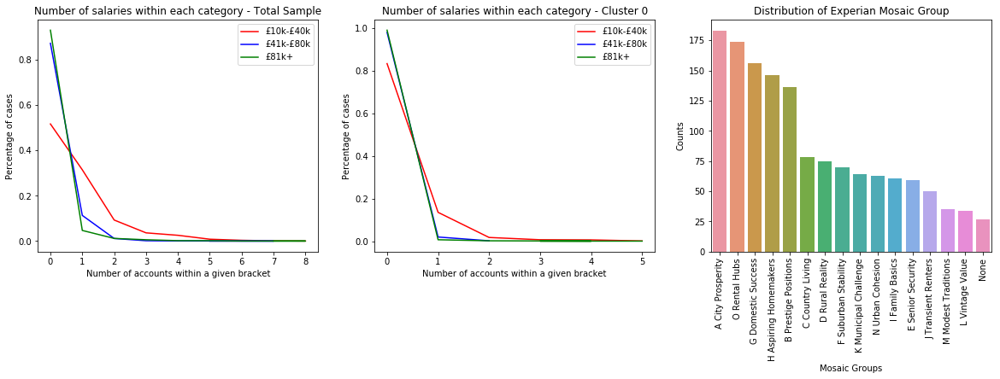

In [68]:
# local var for filter

def PlotHeatMaps(i):
    
    flt = (clusters["GMM"]==i)

    plt.figure(1,figsize=(20,5))
    heatmap(inputFeaturesLogReset, cmap="Spectral")
    plt.title("Heatmap unfiltered,Total Sample,Avg. Income: £%.2f,Avg. Spend, £%.2f,Avg. Age: %.2f" % \
              (np.sum(np.sum(userCombinedReset.iloc[:,DepositsRange])) / len(userCombinedReset), \
              np.abs(np.sum(np.sum(userCombinedReset.iloc[:,SpendRange])) / len(userCombinedReset)), \
              np.mean(userCombinedReset["Age"])), \
                loc='left')
    
    plt.figure(2,figsize=(20,5))
    heatmap(inputFeaturesLogReset[flt], cmap="Spectral")
    plt.title("Heatmap for cluster %d,Cases: %d,Avg Income: £%.2f,Avg. Spend, £%.2f,Avg. Age: %.2f" % \
              (i,sum(flt),np.sum(np.sum(userCombinedReset[flt].iloc[:,DepositsRange])) / len(userCombinedReset[flt]), \
              np.abs(np.sum(np.sum(userCombinedReset[flt].iloc[:,SpendRange])) / len(userCombinedReset[flt])), \
              np.mean(userCombinedReset[flt]["Age"])), \
              loc='left')

    
    plt.figure(3, figsize=(20,5))
    x = inputComponents[clusters["GMM"]==i]
    y = inputComponents[clusters["GMM"]!=i]
    plt.scatter(x[:,0], x[:,1], c='r',alpha=1)
    plt.scatter(y[:,0], y[:,1], c='b',alpha=0.05)
    plt.title("Scatter plot to highlight cluster %d" % (i), loc='left')    
    
    
    x = dfUsersClusters[dfUsersClusters["GMM"]==i].loc[:,['£10k-£40k','£41k-£80k','£81k+']]
    y = dfUsersClusters.loc[:,['£10k-£40k','£41k-£80k','£81k+']]

    plt.figure(4,figsize=(20,5))
    c=['red','blue','green']

    plt.subplot(1,3,1)
    for idx, s in enumerate(['£10k-£40k','£41k-£80k','£81k+']):
        plt.plot(y[s].value_counts(normalize=True),color=c[idx])

    plt.title("Number of salaries within each category - Total Sample")
    plt.legend()
    plt.xlabel("Number of accounts within a given bracket")
    plt.ylabel("Percentage of cases")    
    
    plt.subplot(1,3,2)
    for idx, s in enumerate(['£10k-£40k','£41k-£80k','£81k+']):    
        plt.plot(x[s].value_counts(normalize=True),color=c[idx])

    plt.title("Number of salaries within each category - Cluster %d" % (i))
    plt.legend()
    plt.xlabel("Number of accounts within a given bracket")
    plt.ylabel("Percentage of cases")

    plt.subplot(1,3,3)
    countplot(userCombinedReset[flt]["MosaicGroup"], order = userCombinedReset[flt]["MosaicGroup"].value_counts().index)
    plt.xlabel("Mosaic Groups")
    plt.xticks(rotation='vertical')
    plt.ylabel("Counts")
    plt.title("Distribution of Experian Mosaic Group")

    
PlotHeatMaps(0)

<div style='display:table;border:1px'>
  <div style='float:left;width:60%;height:100%;padding-right:10px'>
    <h4>Cluster 0</h4>
    <h5>Features significantly less than standard</h5>
    <p>Benefits In,Cash In,Winnings In,Rent In, Business, Cash, Childcare, DIY, Food, Fuel, Health, Holidays,Housing,Insurance,Loans, Travel</p>
    <h5>Features significantly more than standard</h5>
      <p><i>Credit Card In</i></p>
  </div>          
  <div style='float:right;width:35%;height:100%'>
      <h4>Commentary</h4>
      <p>This does appear to be quite a distinct cluster, and interestingly overlaps with the DBSCAN clusters of very low income and spend previously identified. It is clear from the heatmaps and confirmed by the average income and spend that this cluster has low deposits and not significant uplift anywhere other than credit card (in) i.e. paying off a credit card. The minimal spend on housing and holiday could indicate that these users potentially could still live at home with their parents, though the average age is quite high for this to be the case. All that said, even within this cluster it would appear that there are 2 potentially 3 sub-clusters, which could be investigated but the number of cases are very low and there is a definite risk of over-fitting<br/>Briefly reviewing the income salary plots would support the argument that cluster 0 has a lot of single incomes within in it. The Mosaic coding also supports this, with the two top categories being focused on single livers and the next two being families.</p>
      <h4>Segment: Low income living with parents</h4>
  </div>
</div>

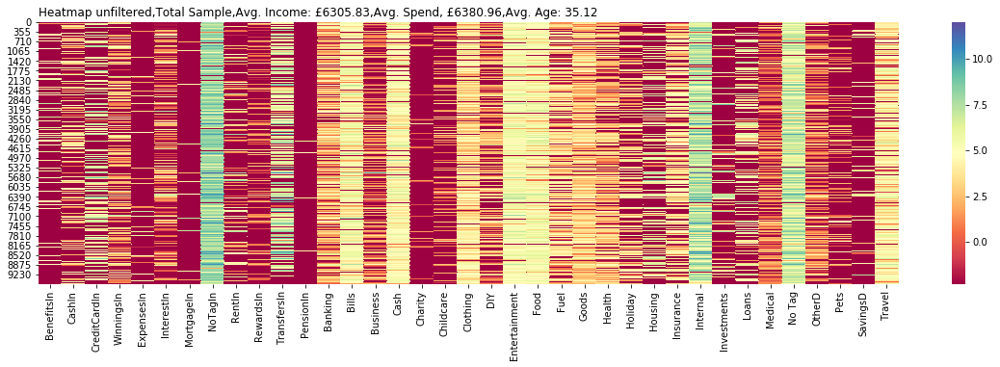

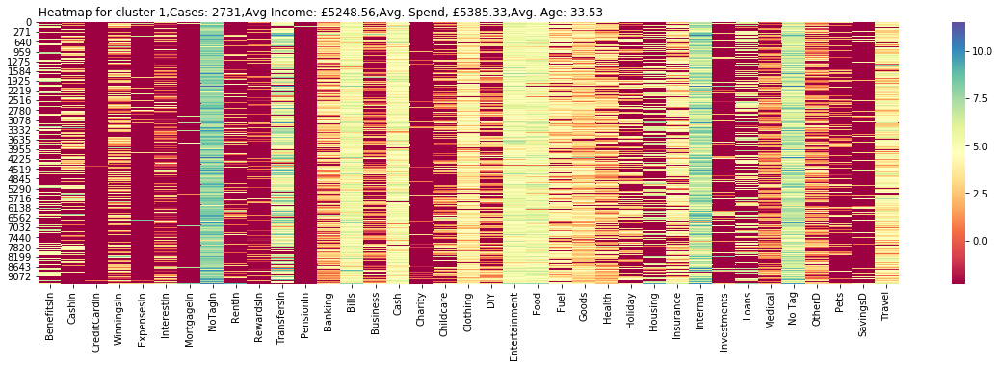

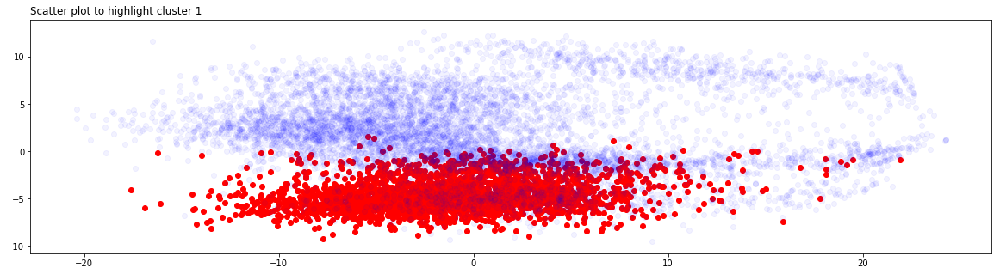

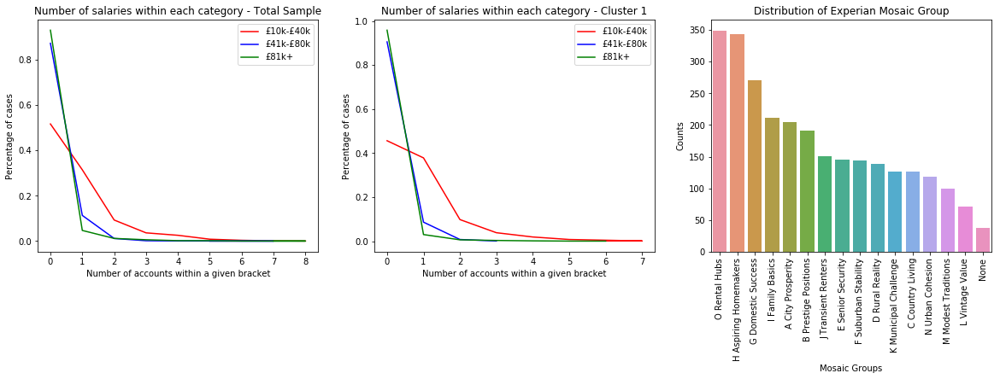

In [69]:
# Run heatmaps and clustering for cluster 1
PlotHeatMaps(1)

<div style='display:table;border:1px'>
  <div style='float:left;width:60%;height:100%;padding-right:10px'>
    <h4>Cluster 1</h4>
    <h5>Features significantly less than standard</h5>
    <p>Credit Card In, Expenses In, Pension In</p>
    <h5>Features significantly more than standard</h5>
      <p><i>Benefits In, Cash In, Winnings In, Childcare, Entertainment, Food, Insurance</i></p>
  </div>          
  <div style='float:right;width:35%;height:100%'>
      <h4>Commentary</h4>
      <p>This is a very distinct segment with only partial overlaps with other data points. It presents a reasonably coherent story, the categories with lift centre around those expected with families and in particular mid-low income families.<br/> One interesting aspect is the absence of credit card payments as this is something that I would associate more with this category so it may not be as clear cut as first impression.<br/>The income plots also helps to verify that there is a high concentration of multiple income households within this cluster. Again the Mosaic coding confirms the cluster definitions.</p>
      <h4>Segment: Average income, families</h4>
  </div>
</div>

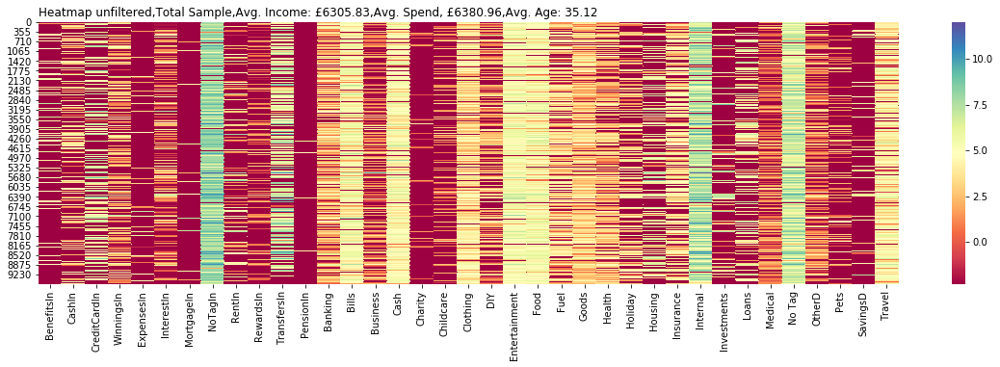

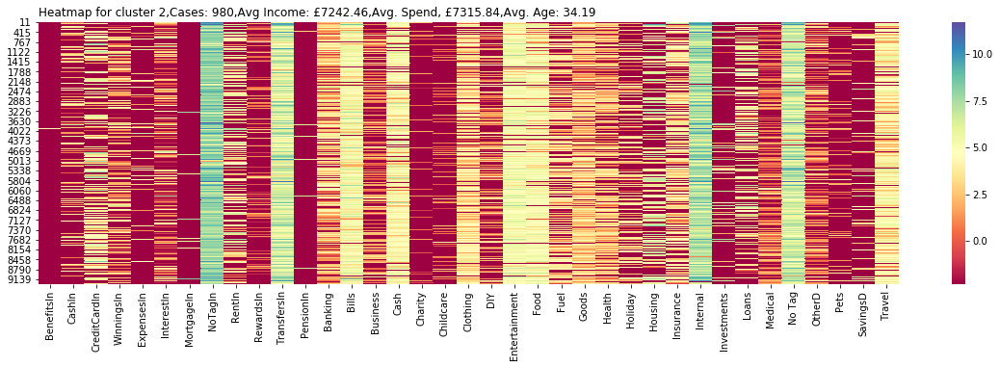

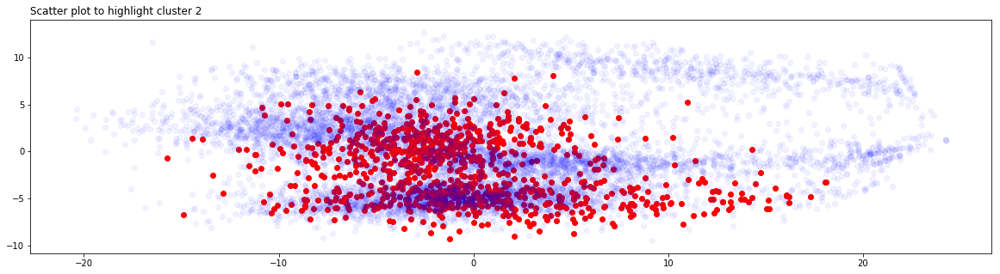

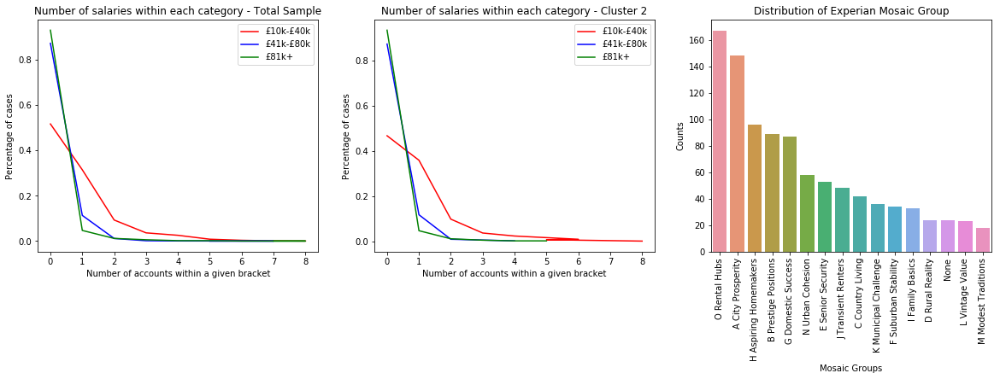

In [70]:
# Run heatmaps and scatterplot for cluster 2
PlotHeatMaps(2)

<div style='display:table;border:1px'>
  <div style='float:left;width:60%;height:100%;padding-right:10px'>
    <h4>Cluster 2</h4>
    <h5>Features significantly less than standard</h5>
    <p>Investments, Childcare</p>
    <h5>Features significantly more than standard</h5>
      <p>Rent In, Transfers In, Loans</p>
  </div>          
  <div style='float:right;width:35%;height:100%'>
      <h4>Commentary</h4>
      <p>This is a slightly confused cluster and a small one so the following comments are not written with a high level of confidence! A quick look at the scatter plot is clear that, it spans a wide area and overlaps with a number of other apparent clusters. That said, I would deduce that this cluster holds a high proportion of young single users based on the markers highlighted.<br/> The one standout and difficult to explain aspect is the very level of transfer, these are account to account transfers and as such do not fit with my speculated group, maybe young couples!<br/> I have run a check on the deposits for Transfer just to check there is nothing obvious missed. The income plots add to the confusion, with a high proportion of multiple incomes.</p>
      <h4>Segment: Young people who love to transfer</h4>
  </div>
</div>

In [71]:
# Double check the contents of Credit Cards In
dfDeposits[dfDeposits["TagName"]=="Transfers"].sample(10).head(10)

,UserSID,TransactionSID,AccountSID,TransactionDate,TransactionDescription,TagName,Amount,Month
210550,42522,154378805,122573,2017-06-01,save the change,Transfers,1.45,6
514992,157094,209064531,626957,2017-11-02,<mdbremoved>,Transfers,377.07,11
68570,54179,163145536,42147,2017-07-11,from a/c xxxx2424 call ref.no. 0000 from a/c...,Transfers,8.00,7
84973,24220,164995904,51994,2017-07-24,<mdbremoved> xxxxxxxxxxxxxx4472,Transfers,500.00,7
304436,91154,156307148,186516,2017-06-10,transfer xxxx9849,Transfers,295.67,6
925488,115176,157997532,431480,2017-06-20,<mdbremoved> xxxxxx xxxx1968,Transfers,400.00,6
701352,31085,161169072,301592,2017-07-05,advice confirms gbh05077amh28bup <mdbremoved>,Transfers,2995.00,7
273743,36435,222991482,166095,2018-01-30,<mdbremoved> xxxxxx xxxx7144,Transfers,250.00,13
40526,42768,179635927,26145,2017-09-13,<mdbremoved> xxxxxx xxxx9768,Transfers,30.00,9
842308,119134,198091743,395721,2017-11-06,<mdbremoved> xxxxxx xxxx1803,Transfers,25.00,11


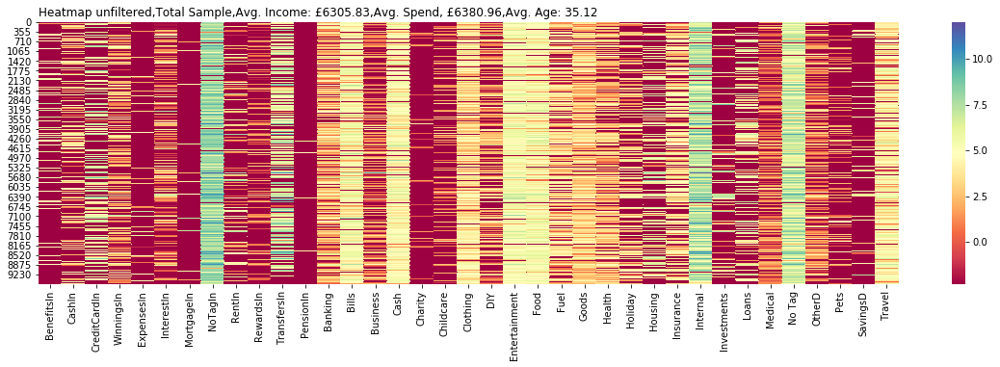

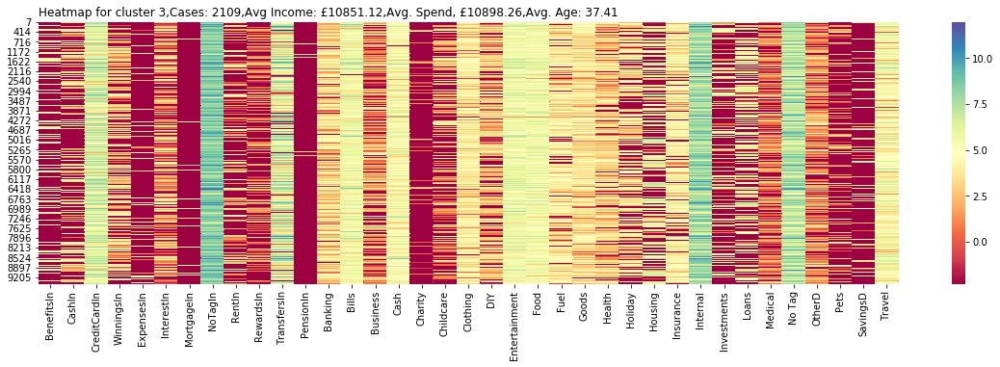

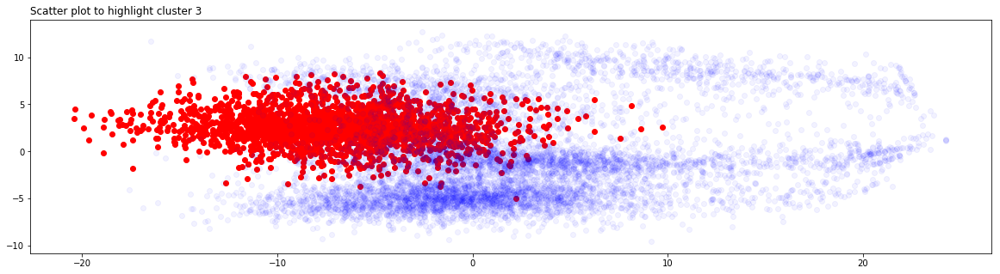

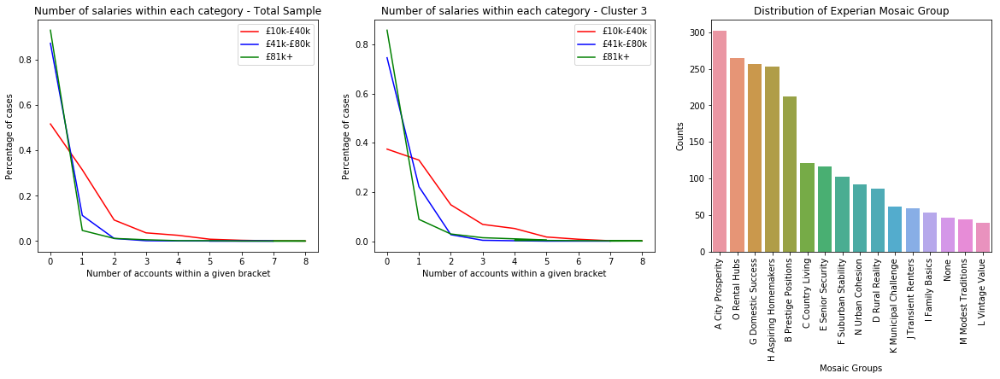

In [72]:
# Run heatmaps and scatter for cluster 3
PlotHeatMaps(3)

<div style='display:table;border:1px'>
  <div style='float:left;width:60%;height:100%;padding-right:10px'>
    <h4>Cluster 3</h4>
    <h5>Features significantly less than standard</h5>
    <p></p>
    <h5>Features significantly more than standard</h5>
      <p>Benefits In, Cash In, Credit Cards In, Winings In, Transfers In, Banking, Bills, Business, Cash, Childcare, Clothes, DIY, Entertainment, Food, Fuel, Goods, Health, Holiday, Housing, Insurance, Investments, Loans, Travel</p>
  </div>          
  <div style='float:right;width:35%;height:100%'>
      <h4>Commentary</h4>
      <p>This is quite a compact cluster and as such I would expect it to be quite coherent. It is clear from the category markers and confirmed by the average spend that this cluster includes households that are about national average. Taking age into account, I would conclude that this cluster contained families in advanced stages of life a lot with children, hence the high spend on food and goods etc. The high income would point towards double income so I would expect there to be multiple incomes.Again the income plots supports the commentary, both with multiple income households but also high salary incomes as well. is clear from the plot that cluster 3 has more multiple incomes as a percentage than the other clusters combined. Interestingly the Mosaic coding seems to point towards more single people in this cluster but the evidence from the heatmaps and income bands challenges this. More investigations are needed to determine which is the more accurate model.</p>
      <h4>Segment: Well heeled families</h4>
  </div>
</div>

In [73]:
# Double check the contents of Credit Cards In
dfDeposits[dfDeposits["TagName"]=="Credit Card"].sample(10).head(10)

,UserSID,TransactionSID,AccountSID,TransactionDate,TransactionDescription,TagName,Amount,Month
1115121,160749,220951641,646637,2018-01-01,direct debit payment - th,Credit Card,37.98,13
1089326,160105,234758937,637096,2018-02-26,"payment, thank you",Credit Card,200.00,14
1064187,97959,191624869,500335,2017-10-16,<mdbremoved>,Credit Card,360.61,10
366410,123959,207871445,521845,2017-12-30,<mdbremoved>,Credit Card,1571.97,12
165483,29787,264633892,95008,2018-05-31,payment received - than,Credit Card,41.67,17
124852,61049,165590172,72916,2017-07-26,payment received - thank you,Credit Card,500.00,7
576069,42764,188772802,223515,2017-10-04,payment received -- thank you 00,Credit Card,70.00,10
937437,117423,167713733,436524,2017-08-02,payment received -- thank,Credit Card,10.00,8
1058572,100595,168941780,497333,2017-08-05,payment received - than,Credit Card,223.01,8
841441,107431,263577651,395227,2018-05-25,payment received - than,Credit Card,100.00,17


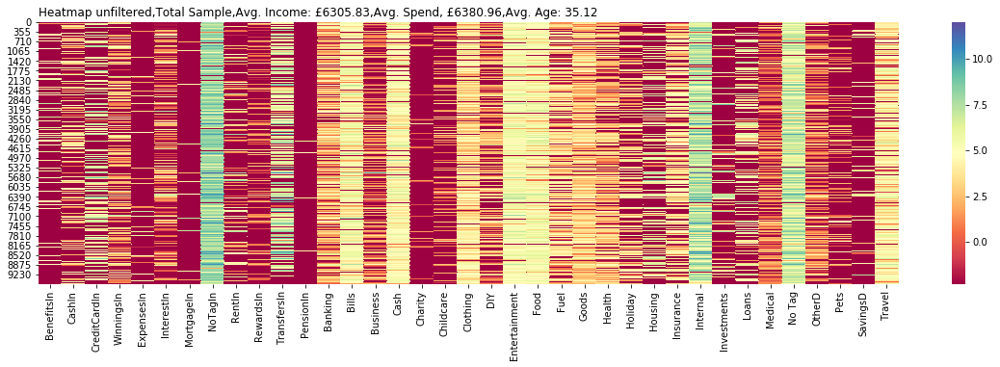

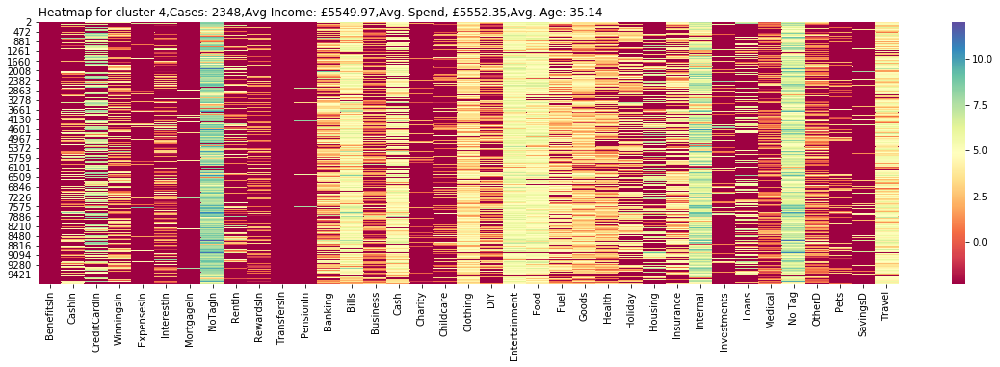

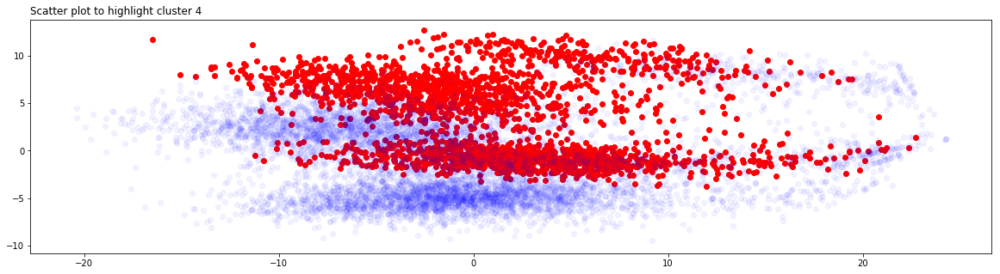

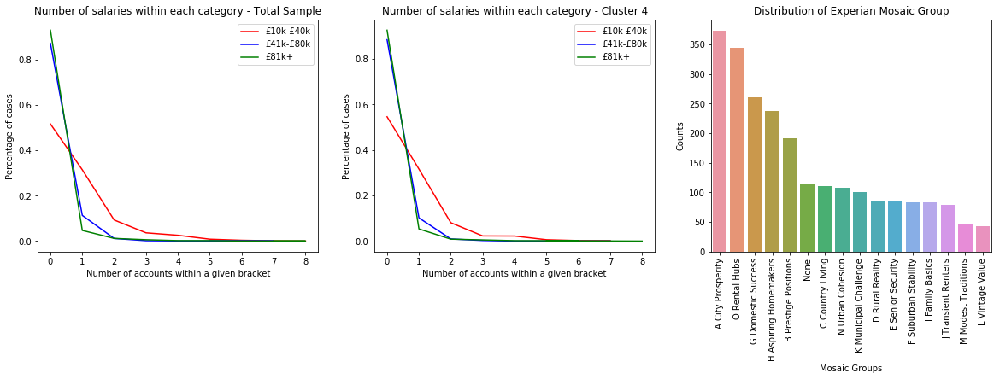

In [74]:
# Heatmaps and scatter plots for cluster 4
PlotHeatMaps(4)

<div style='display:table;border:1px'>
  <div style='float:left;width:60%;height:100%;padding-right:10px'>
    <h4>Cluster 4</h4>
    <h5>Features significantly less than standard</h5>
        <p>Transfer In</p>
    <h5>Features significantly more than standard</h5>      
      <p><i>None</i></p>
  </div>          
  <div style='float:right;width:35%;height:100%'>
      <h4>Commentary</h4>
      <p>The only factor that seems to drive this cluster is the lack of Transfer into the account. The rest of the heatmap is broadly in line with the average. Reviewing the scatter plot, it would appear that there are at least 2 distinct clusters within this cluster, which is the likely cause of the confused heatmaps. isolating and re-clustering may provide a clearer picture of the subsets of data within here. Unsuprisingly the income plots do not add any clarity, nor would I expect it to considering how widely dispersed the cluster is.</p>
      <h4>Segment: Confused</h4>
  </div>
</div>

# Conclusion

<p>Although far from perfect the results show sufficient cohesion for me to believe that it is possible to use bank transaction data to segment users. When this is then married to the merchant spend this could be a powerful tool for companies to both understand their user base as well as their competitors. This could be then used to build effective, targeted, marketing plans.</p>

<p>There are still a number of challenges before it would be viable product, some model based, some data provider based. These include:<p>
<ul>
    <li>The tagging of merchant was something that I had hoped to apply some NLP techniques in order to get better merchant tagging but due to the amount of redaction and also time, I was unable to achieve this</li>
    <li>Outliers seem to be a whole project in itself, reviewing highlighted a number of complex transaction combinations, which needed in depth analysis to try to explain. One example being extremely high winnings figures, over a consistent period!</li>
    <li>I believe the zero-inflated data weakens the model and I was dissatisfied with how I dealt with that, more investigations needed here</li>
</ul>